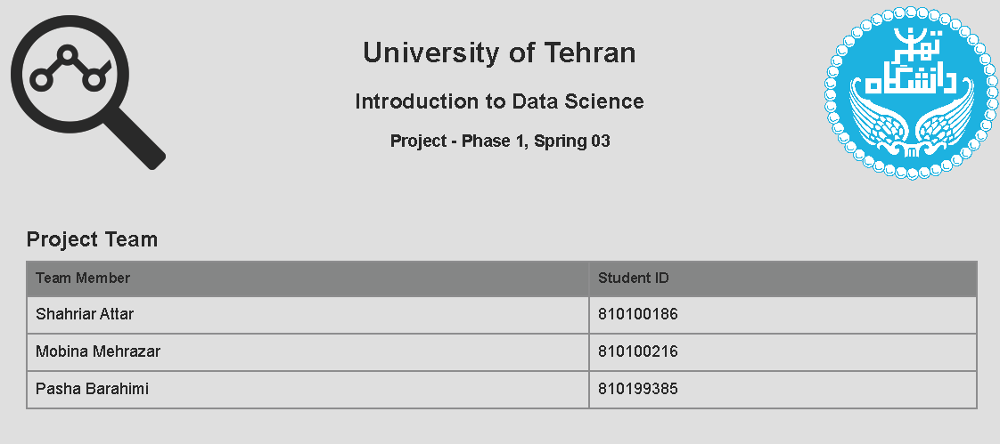

# Project - Phase 1 - EDA

## Introduction

The dataset contains information about car features and their selling price in South Africa. The objective is to predict the selling price of the cars based on the features provided.

## Objectives

The purpose of this phase is as follows:

1. To perform EDA to understand the data better.

## Tasks

- Exploratory Data Analysis (EDA)

## Dataset Description

The dataset consists of the following columns:

- `id`: The unique identifier for a car in the dataset.
- `Make`: The brand of the car.
- `Model`: The model of the car.
- `Features`: The extra features of the car.
- `Kilowatts`: The power of the car in kilowatts.
- `Cylinder Layout`: The number of cylinders and thei layout.
- `Finance Price`: The price of the car if financed per month.
- `Mileage`: The number of miles the car has been driven.
- `Gears`: The number of gears in the car.
- `Fuel Type`: The type of fuel the car uses (e.g. Petrol, Diesel, Electric).
- `No of Seats`: The number of seats in the car.
- `Registration Year`: The year the car was registered.
- `Colour`: The colour of the car.
- `No of Doors`: The number of doors in the car.
- `Spare Key`: Whether the car has a spare key or not.
- `Fuel Consumption`: The fuel consumption of the car.
- `Dekra`: The Dekra condition report of the car. Dekra is a vehicle inspection company.
- `Variant`: The variant of the car.
- `Drive`: The car drive type (e.g. Front Wheel Drive, Rear Wheel Drive, Four Wheel Drive).
- `Body Type`: The body type of the car.
- `Vehicle Service History`: The service history of the car.
- `Maintenance Plan`: The maintenance plan data of the car (if any).
- `Fuel Tank`: The fuel tank capacity of the car.
- `Parking bay number`: The parking bay number of the car.
- `Category`: The category of the car. This shows the working condition of the car. 'A' means the car is in good condition and is newer, while 'B' means the car is a bit older and may not be in the best condition.
- `NaTIS Vehicle status`: The NaTIS (National Administration Traffic Information System) status of the car. This document is the car's birth certificate and contains all the information about the car.
- `Engine Capacity`: The engine capacity of the car.
- `Branch`: The branch where the car is located.
- `Warranty`: The warranty of the car (if any).
- `Transmission`: The transmission type of the car (e.g. Manual, Automatic).
- `Price`: The selling price of the car.

## Environment Setup

We'll begin by setting up your Python environment and installing the necessary libraries.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.preprocessing import LabelEncoder
from sklearn.impute import KNNImputer

from ydata_profiling import ProfileReport

from typing import Optional
import re

In [2]:
DATA_PATH = "../data/cars.csv"
CLEANED_DATA_PATH = "../data/cars_cleaned.csv"
PROCESSED_DATA_PATH = "../data/cars_processed.csv"

MAKE_MODELS_PATH = "../data/make_models/{make}_models.txt"

## Steps

### Exploratory Data Analysis (EDA)

#### Load the Preprocessed and Cleaned Data

In [3]:
df_cleaned = pd.read_csv(CLEANED_DATA_PATH)
df_processed = pd.read_csv(PROCESSED_DATA_PATH)

In [4]:
df_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6092 entries, 0 to 6091
Data columns (total 26 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Make                     6092 non-null   object 
 1   Model                    6092 non-null   object 
 2   Registration Year        6092 non-null   int64  
 3   Mileage                  6092 non-null   int64  
 4   Body Type                6092 non-null   object 
 5   Category                 6092 non-null   object 
 6   Colour                   6092 non-null   object 
 7   Cylinder Layout          6092 non-null   object 
 8   Dekra                    6092 non-null   object 
 9   Drive                    6092 non-null   object 
 10  Engine Capacity          6092 non-null   int64  
 11  Features                 6092 non-null   object 
 12  Finance Price            6092 non-null   int64  
 13  Fuel Consumption         6092 non-null   float64
 14  Fuel Tank Capacity      

In [5]:
df_processed.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4974 entries, 0 to 4973
Data columns (total 49 columns):
 #   Column                                  Non-Null Count  Dtype  
---  ------                                  --------------  -----  
 0   Age                                     4974 non-null   int64  
 1   Body Type_Bus                           4974 non-null   bool   
 2   Body Type_Cabriolet                     4974 non-null   bool   
 3   Body Type_Coupe                         4974 non-null   bool   
 4   Body Type_Crossover (SUV)               4974 non-null   bool   
 5   Body Type_Hatchback                     4974 non-null   bool   
 6   Body Type_Multi Purpose Vehicle         4974 non-null   bool   
 7   Body Type_Other                         4974 non-null   bool   
 8   Body Type_Sedan                         4974 non-null   bool   
 9   Body Type_Sports Utility Vehicle (SUV)  4974 non-null   bool   
 10  Body Type_Station Wagon                 4974 non-null   bool

#### Summary Statistics

In [6]:
df_cleaned.describe()

,Registration Year,Mileage,Engine Capacity,Finance Price,Fuel Consumption,Fuel Tank Capacity,Gears,Kilowatts,No of Doors,No of Seats,Price
count,6092.000000,6092.000000,6092.000000,6092.000000,6092.000000,6092.000000,6092.000000,6092.000000,6092.000000,6092.000000,6.092000e+03
mean,2015.432042,127381.421701,2006.134767,4790.159718,7.036962,59.948785,6.206172,124.933684,4.611950,5.208634,2.418348e+05
std,4.247221,70812.192041,820.451412,3337.886983,2.045602,15.879327,1.199316,56.729524,0.759837,1.019255,1.878613e+05
min,1998.000000,27.000000,796.000000,648.000000,2.100000,27.000000,4.000000,38.000000,2.000000,2.000000,1.590000e+04
25%,2013.000000,76000.000000,1496.000000,2550.000000,5.600000,50.000000,5.000000,85.000000,4.000000,5.000000,1.159000e+05
50%,2016.000000,119139.000000,1969.000000,3922.000000,6.500000,59.000000,6.000000,115.000000,5.000000,5.000000,1.889000e+05
75%,2019.000000,169121.250000,2199.000000,6013.000000,8.000000,70.000000,7.000000,140.000000,5.000000,5.000000,3.119000e+05
max,2024.000000,712479.000000,6417.000000,43148.000000,17.790000,150.000000,10.000000,460.000000,6.000000,16.000000,2.352900e+06


In [7]:
df_processed.describe()

,Age,Category,Dekra,Engine Capacity,Finance Price,Fuel Consumption,Fuel Tank Capacity,Gears,Horsepower,Make Model,Mileage,No of Cylinders,No of Doors,No of Seats,Remaining Maintenance Plan,Remaining Warranty,Transmission,Vehicle Service History,Price
count,4974.000000,4974.000000,4974.000000,4974.000000,4974.000000,4974.000000,4974.000000,4974.000000,4974.000000,4974.000000,4974.000000,4974.000000,4974.000000,4974.000000,4974.000000,4974.000000,4974.000000,4974.000000,4974.000000
mean,8.561118,0.316446,0.640330,1885.184359,4331.873341,6.719162,58.701448,6.165862,155.944126,81.661037,129660.969240,4.093687,4.734218,5.256534,3.224970,15.287897,0.401488,1.520507,216099.195818
std,3.731673,0.465136,0.843416,635.926942,2425.096750,1.683802,13.967743,1.177420,57.731187,49.272141,63592.668448,0.728929,0.513763,0.780656,28.938077,82.027468,0.490249,1.534863,135366.140701
min,1.000000,0.000000,0.000000,796.000000,648.000000,3.400000,27.000000,4.000000,50.958760,0.000000,1554.000000,3.000000,3.000000,3.000000,0.000000,0.000000,0.000000,0.000000,15900.000000
25%,6.000000,0.000000,0.000000,1461.000000,2540.000000,5.500000,49.000000,5.000000,113.986700,31.000000,83000.000000,4.000000,5.000000,5.000000,0.000000,0.000000,0.000000,0.000000,115900.000000
50%,8.000000,0.000000,0.000000,1968.000000,3740.000000,6.370000,57.000000,6.000000,147.512200,86.000000,123133.500000,4.000000,5.000000,5.000000,0.000000,0.000000,0.000000,1.000000,179000.000000
75%,11.000000,1.000000,1.000000,2000.000000,5540.000000,7.800000,67.000000,7.000000,181.037700,130.000000,170689.000000,4.000000,5.000000,5.000000,0.000000,0.000000,1.000000,3.000000,284900.000000
max,21.000000,1.000000,2.000000,3984.000000,14724.000000,13.000000,105.000000,9.000000,384.872740,161.000000,337000.000000,6.000000,6.000000,8.000000,445.000000,716.000000,1.000000,4.000000,789900.000000


#### Profile Report

In [8]:
ProfileReport(df_cleaned, title="Cleaned Data Profile Report", explorative=True)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [9]:
ProfileReport(df_processed, title="Cleaned Data Profile Report", explorative=True)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [10]:
%matplotlib inline

#### Correlation Matrix

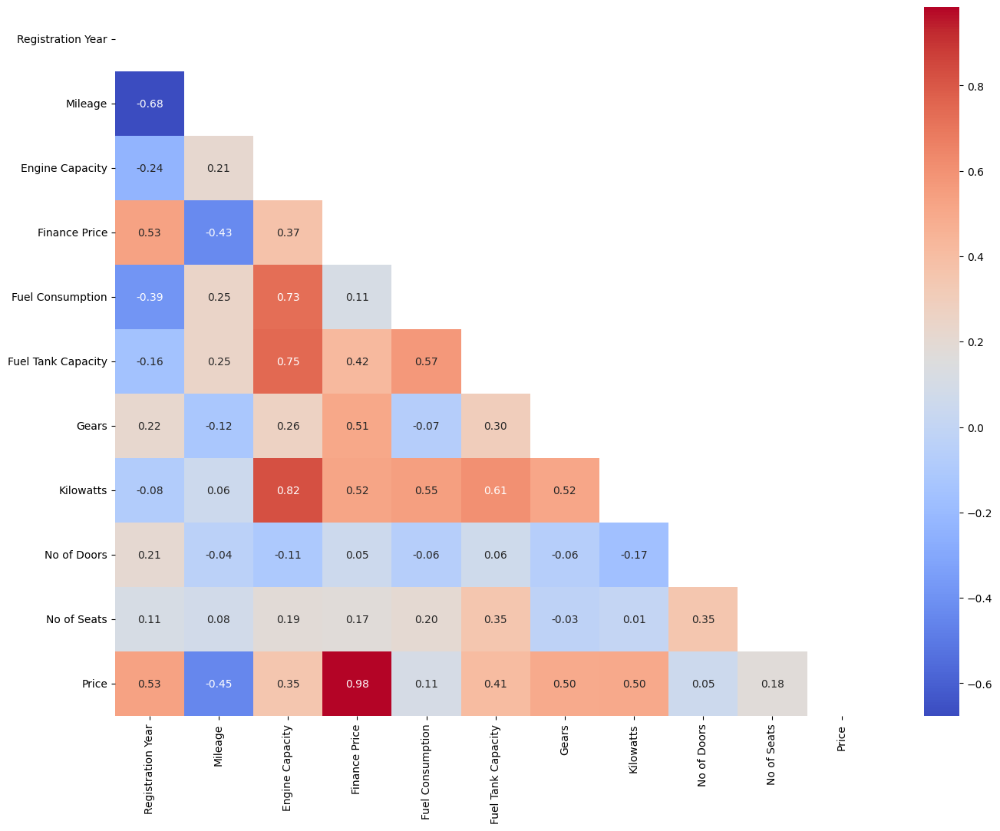

In [11]:
numeric_cols = df_cleaned.select_dtypes(include=[np.number]).columns
corr_matrix = df_cleaned[numeric_cols].corr()
mask = np.triu(np.ones_like(corr_matrix, dtype=bool))

plt.figure(figsize=(16, 12))
sns.heatmap(corr_matrix, annot=True, fmt=".2f", mask=mask, cmap="coolwarm")
plt.show()

As we can see, the `Price` column has a high correlation with the `Finance Price` column. This is expected as the selling price of the car is usually related to the finance price.

Also, the `Engine Capacity` column has a high correlation with the `Kilowatts`, `Fuel Tank Capacity` and `Fuel Consumption` columns. This is expected as the engine capacity of the car is related to these features.

At last, The `Mileage` column has a high correlation with the `Registration Year` column. This is expected as the mileage of the car increases with the age of the car.

#### Distributions

In [12]:
def hist_plot(df: pd.DataFrame, column: str) -> None:
    plt.figure(figsize=(12, 8))
    sns.histplot(df[column], kde=True)  # type: ignore
    plt.title(f"{column} Histogram")
    plt.show()

In [13]:
def bar_plot(df: pd.DataFrame, column: str, horizontal: bool=False) -> None:
    plt.figure(figsize=(12, 8))
    if horizontal:
        sns.countplot(y=column, data=df)
    else:
        sns.countplot(x=column, data=df)
    plt.title(f"{column} Bar Plot")
    plt.show()

In [14]:
def box_plot(df: pd.DataFrame, column: str) -> None:
    plt.figure(figsize=(12, 8))
    sns.boxplot(data=df, x=column)
    plt.title(f"{column} Box Plot")
    plt.show()

##### Registration Year

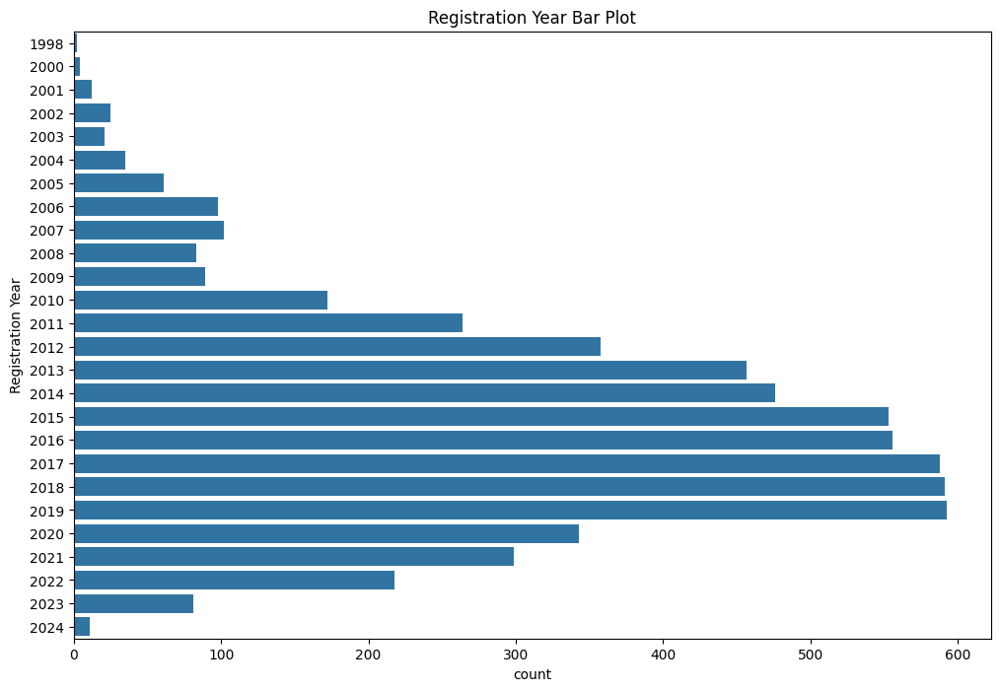

In [15]:
bar_plot(df_cleaned, "Registration Year", horizontal=True)

As it is visible in the above plot, the distribution of the `Registration Year` column is almost a normal distribution. Most of the cars being sold are from the year 2013 to 2020. We could have expected this because very old cars and very new cars are not usually sold. Also, some of the very old cars may be considered as antiques and not sold in the regular market.

##### Mileage

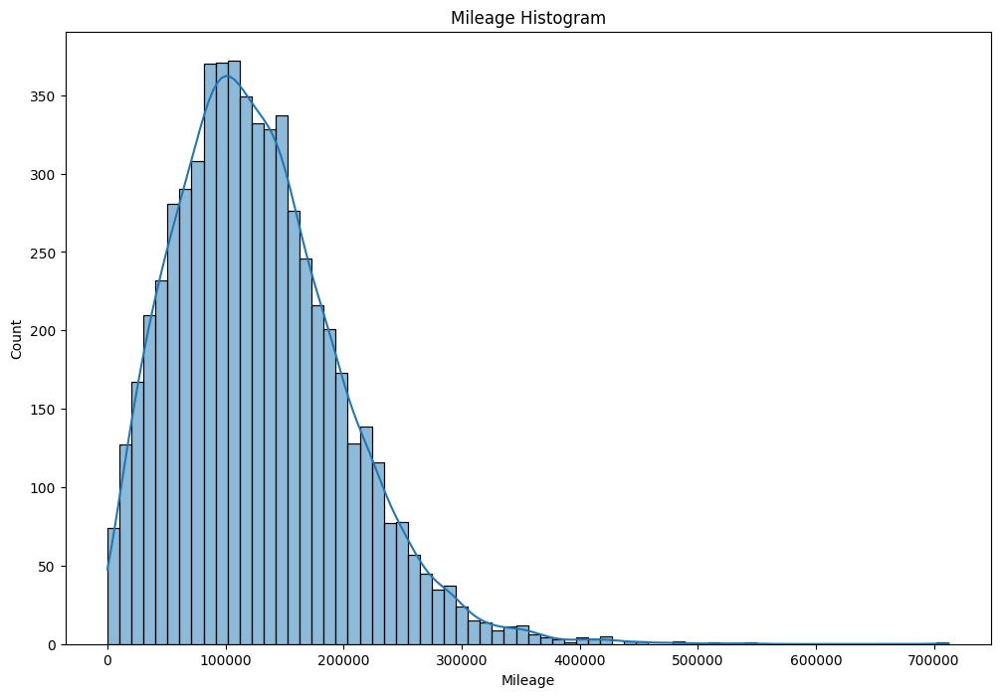

In [16]:
hist_plot(df_cleaned, "Mileage")

The above plot shows that the `Mileage` column is also normally distributed. Most of the cars being sold have a mileage of around 100,000 km. We can explain this with the same logic as the `Registration Year` column. The cars that have a mileage more than 300,000 km are very few and they are usually dismantled for parts.

##### Category

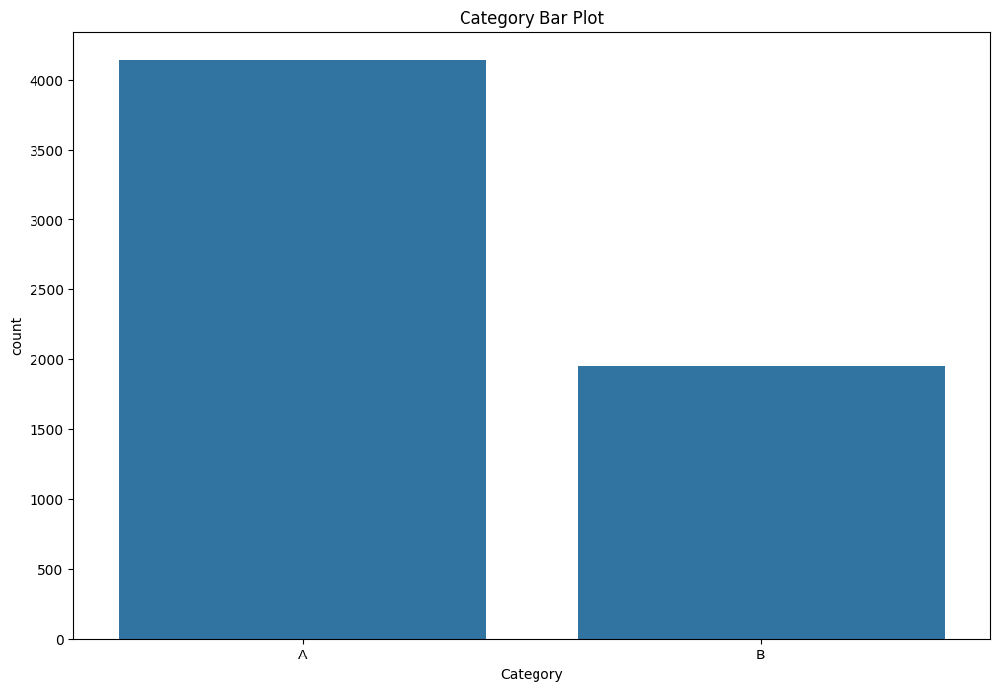

In [17]:
bar_plot(df_cleaned, "Category")

As we can see, the cars in category 'A' are about twice as many as the cars in category 'B'.

##### No of Cylinder

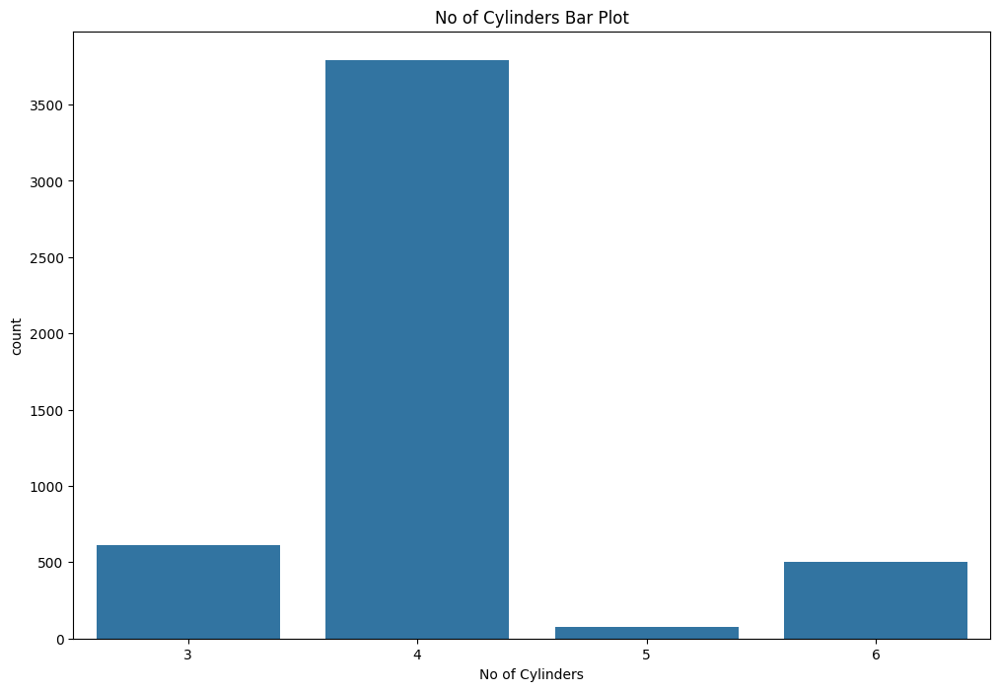

In [18]:
bar_plot(df_processed, "No of Cylinders")

Most of the cars have 4 cylinders. The number of cars with 6 cylinders and 3 cylinders are almost the same and are about one-sixth of the number of cars with 4 cylinders.

##### Dekra

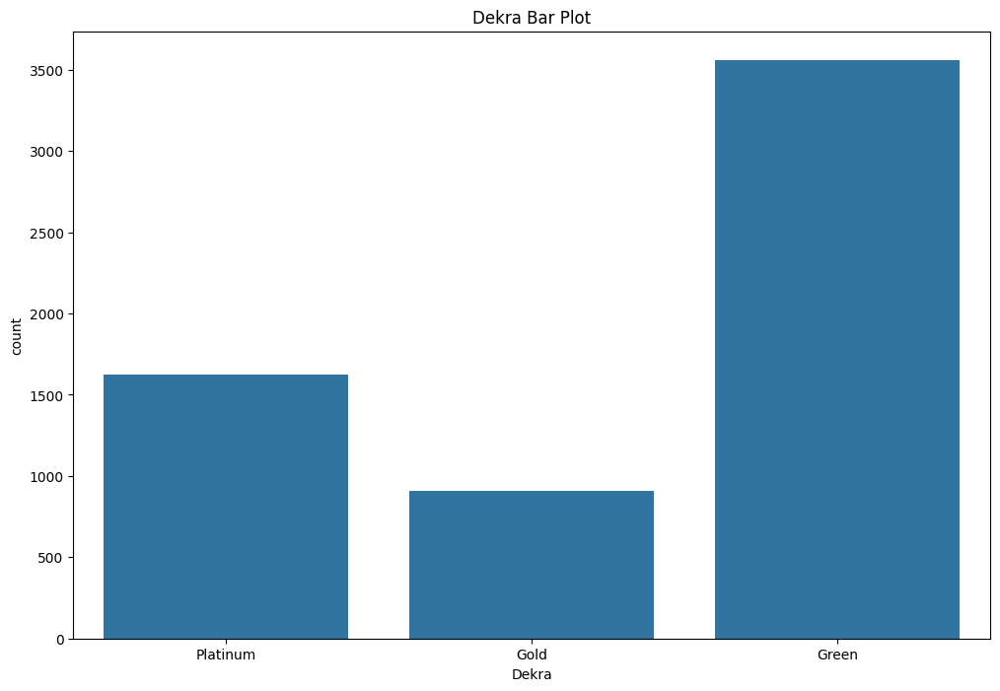

In [19]:
bar_plot(df_cleaned, "Dekra")

Most of the cars have a Dekra condition report of 'Green' which is the worst condition. After that, the cars with a Dekra condition report of 'Platinum' are the most common and are about twice as many as the cars with a Dekra condition report of 'Gold'.

##### Drive

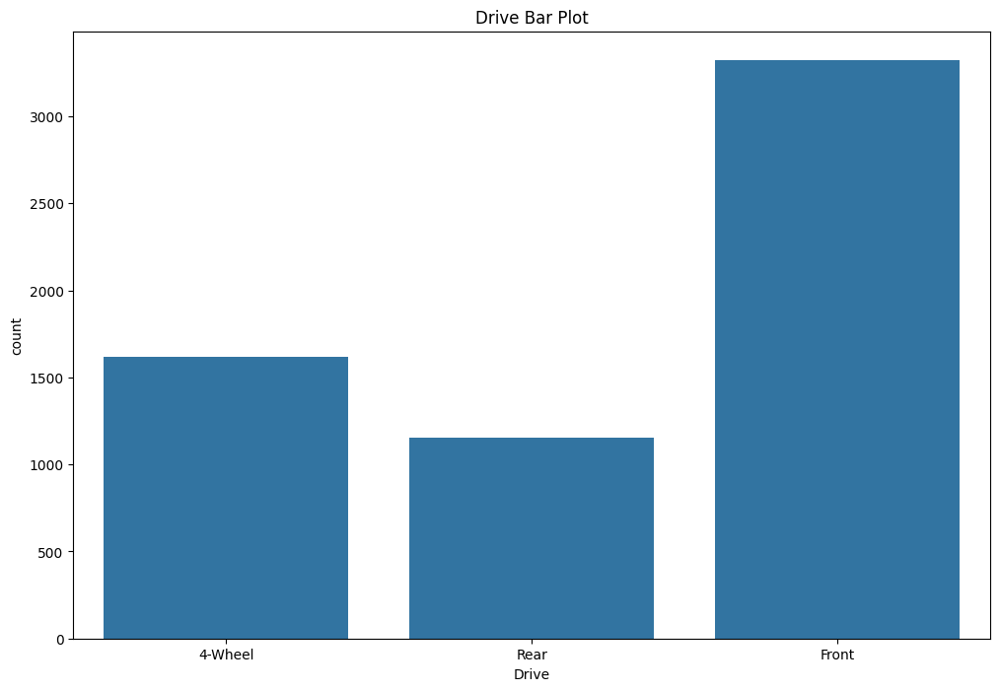

In [20]:
encoding_drive = {
    "F": "Front",
    "R": "Rear",
    "FR": "4-Wheel",
}
df_temp = df_cleaned.copy()
df_temp["Drive"] = df_temp["Drive"].apply(lambda x: encoding_drive[x])
bar_plot(df_temp, "Drive")

Most of the cars are Front Wheel Drive and it is about twice as many as the 4 Wheel Drive cars. The Rear Wheel Drive cars are the least common.

##### Engine Capacity

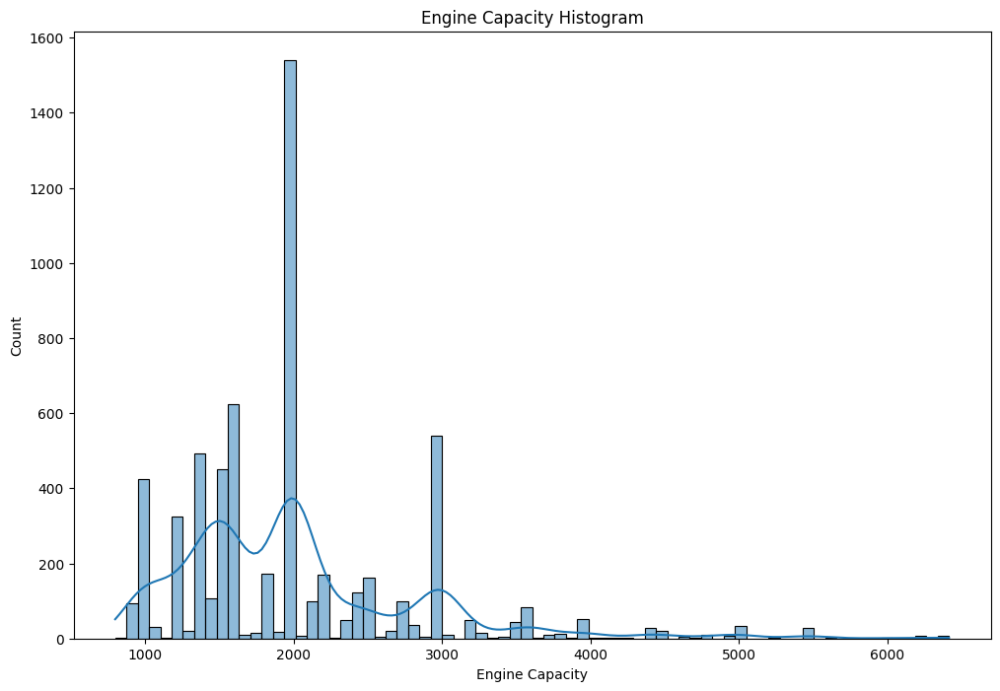

In [21]:
hist_plot(df_cleaned, "Engine Capacity")

The distribution of `Engine Capacity` is not a known distribution. However, most of the cars have an engine capacity of around 2000cc. The next 2 are 1600cc and 3000cc.

##### Finance Price

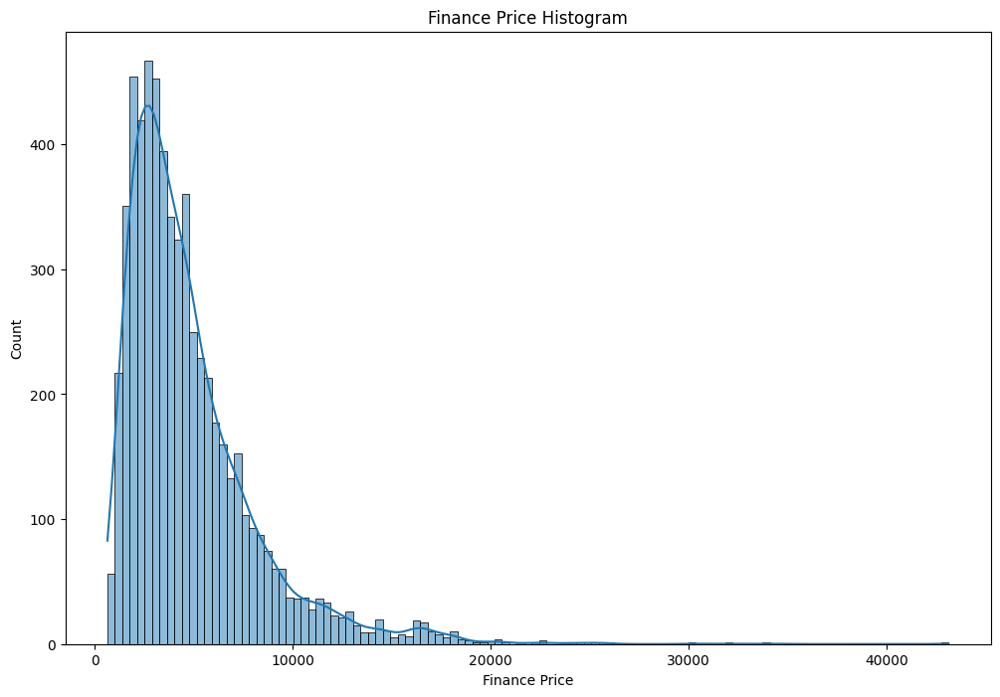

In [22]:
hist_plot(df_cleaned, "Finance Price")

The distribution of the `Finance Price` column is approximately a normal distribution which is right-skewed.

##### Fuel Consumption

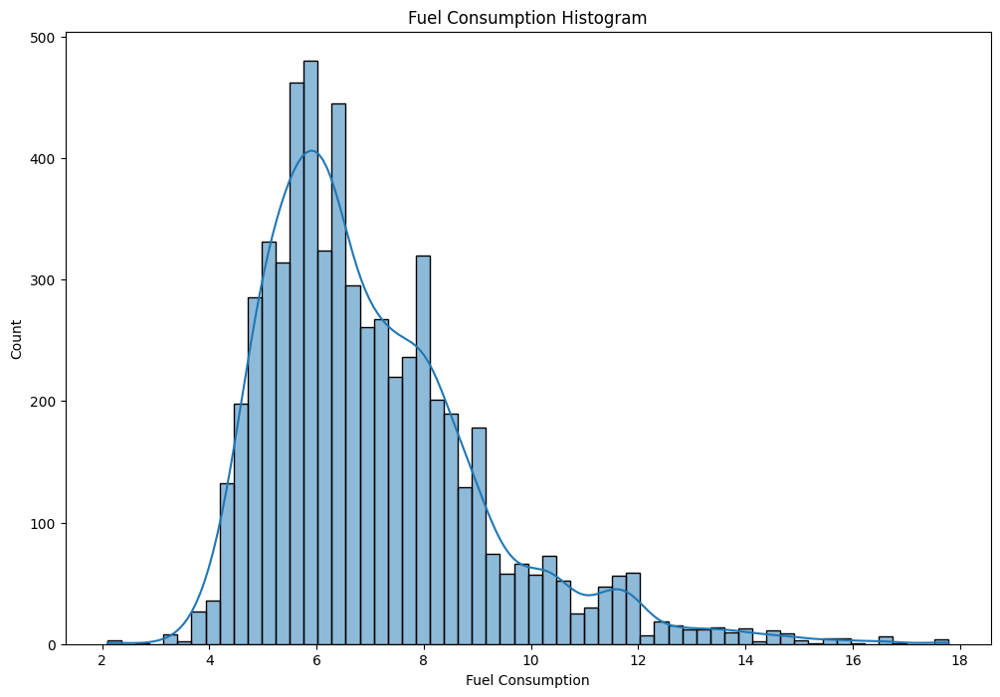

In [23]:
hist_plot(df_cleaned, "Fuel Consumption")

The distribution of the `Fuel Consumption` column is like a normal distribution with a peak at about 6. However, the distribution is not completely normal.

##### Fuel Tank Capacity

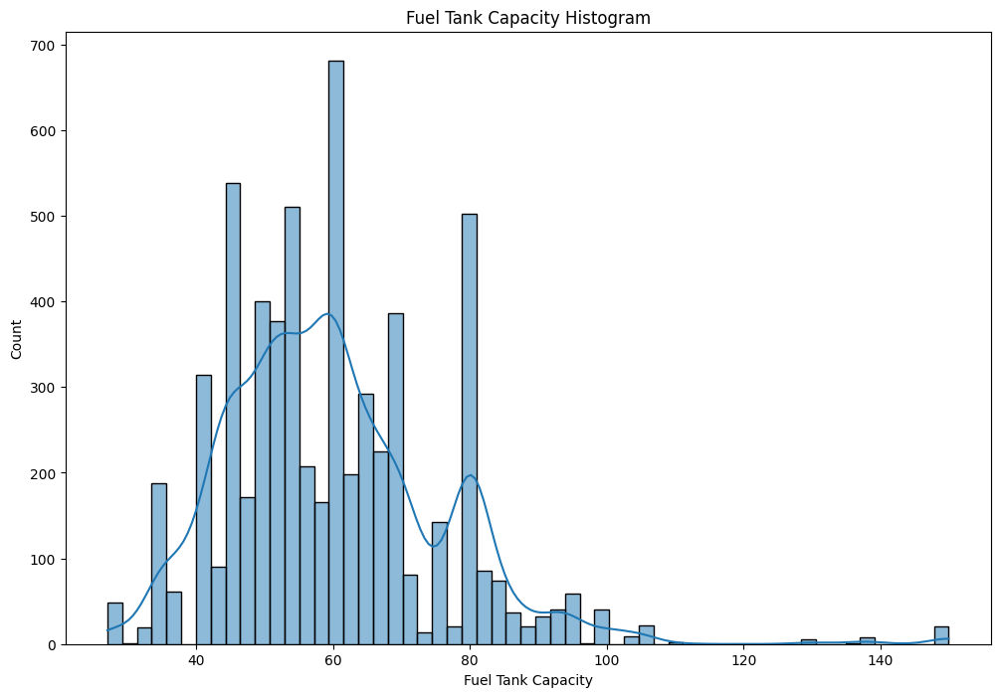

In [24]:
hist_plot(df_cleaned, "Fuel Tank Capacity")

The distribution of the `Fuel Tank Capacity` column is not a known distribution. However, most of the cars have a fuel tank capacity of around 60 liters.

##### Fuel Type

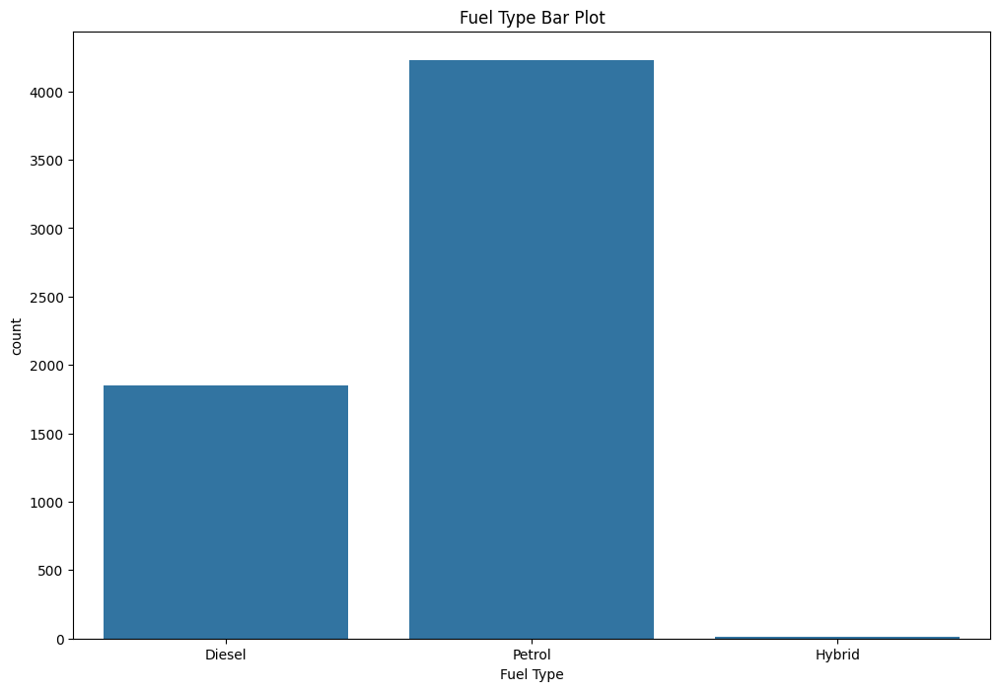

In [25]:
bar_plot(df_cleaned, "Fuel Type")

As we can see, the most common fuel type is Petrol, followed by Diesel. Hybrid is the least common fuel type.

##### Gears

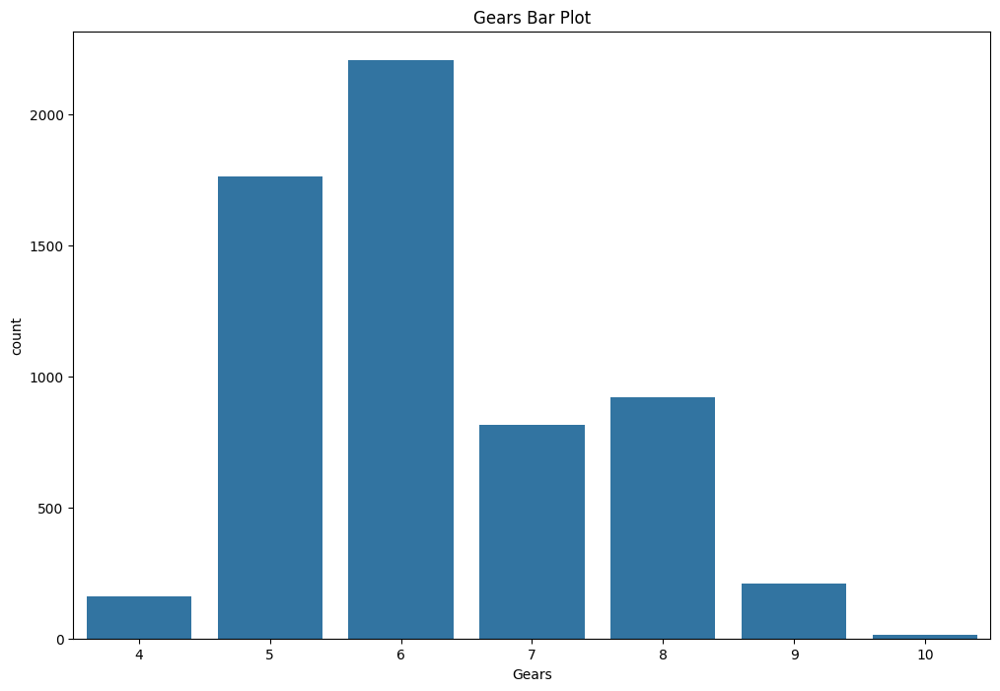

In [26]:
bar_plot(df_cleaned, "Gears")

Most of the cars have 6 gears. The number of cars with 5 gears is a little less than the number of cars with 6 gears. The number of cars with 10 gears is the least common.

##### Horsepower

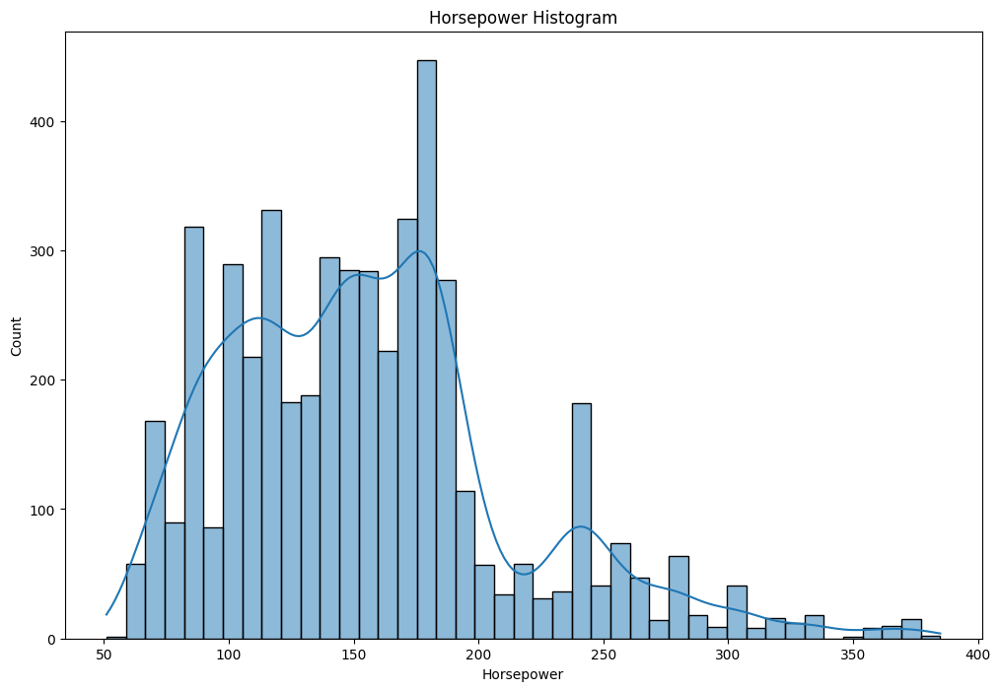

In [27]:
hist_plot(df_processed, "Horsepower")

The distribution of the `Horsepower` column is not a known distribution. However, most of the cars have a horsepower of around 180. The next most common horsepower is around 150.

##### Remaining Maintenance Plan

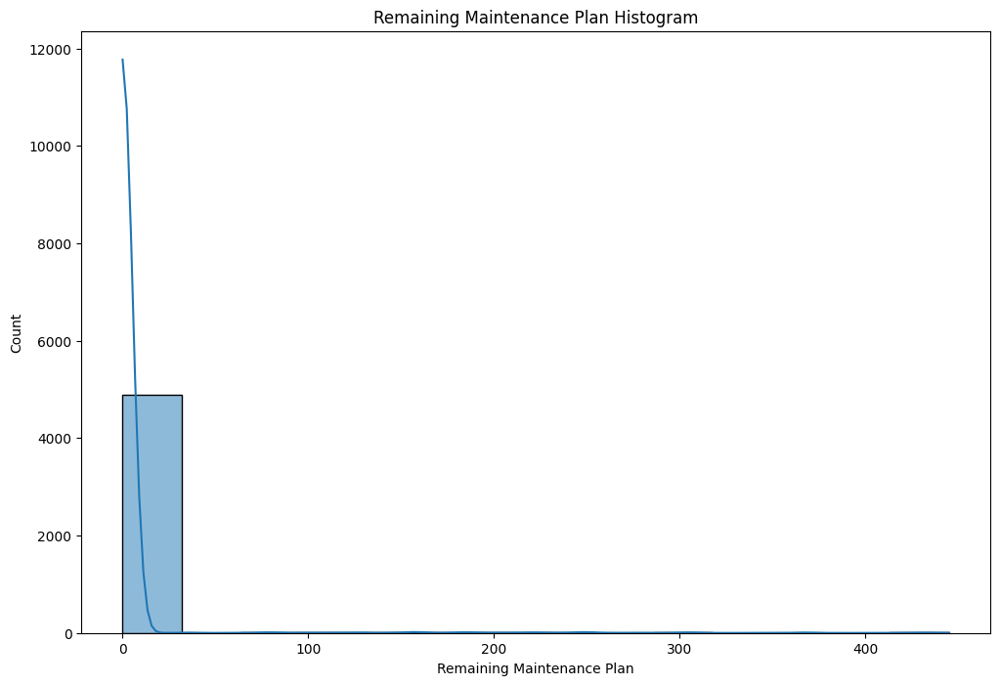

In [28]:
hist_plot(df_processed, "Remaining Maintenance Plan")

As we can see, most of the cars don't have a maintenance plan.

##### Remaining Warranty

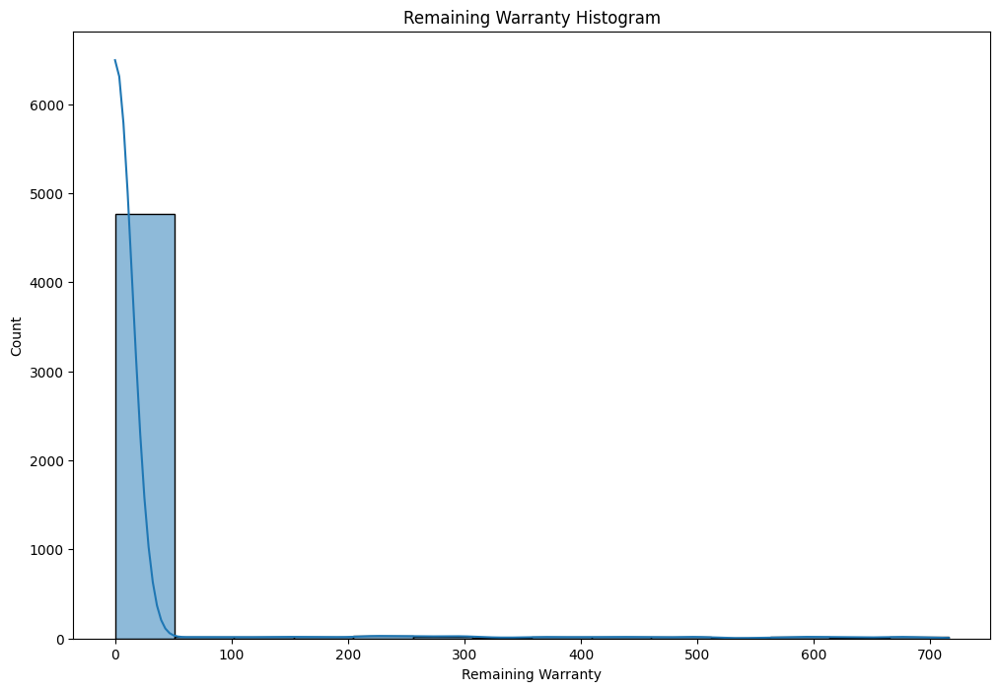

In [29]:
hist_plot(df_processed, "Remaining Warranty")

This is the same as the `Remaining Maintenance Plan` column. Most of the cars don't have a warranty.

##### No of Doors

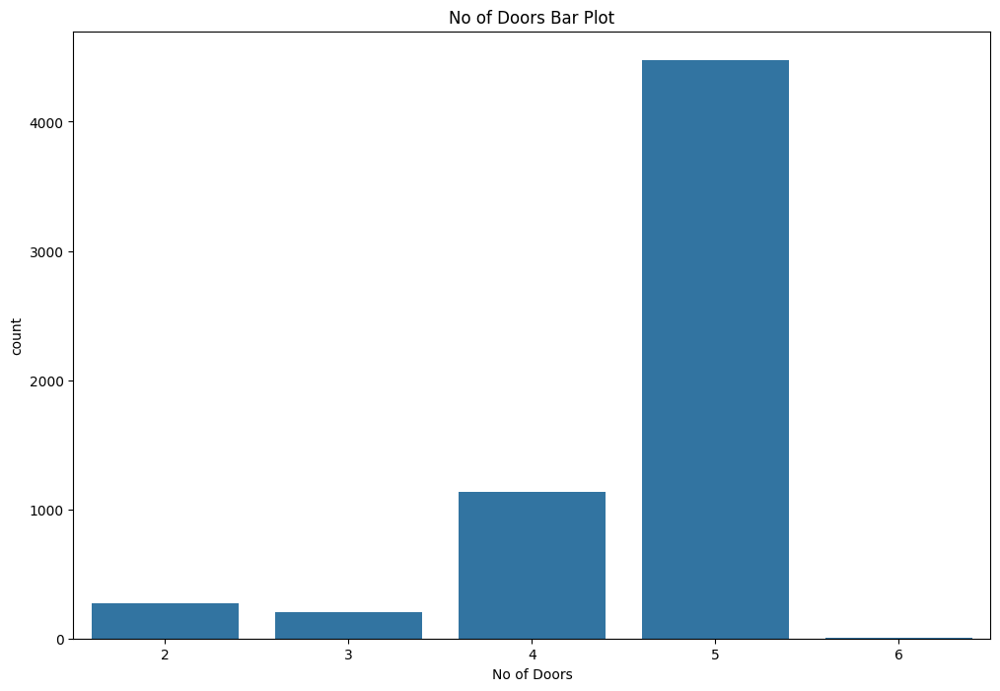

In [30]:
bar_plot(df_cleaned, "No of Doors")

The most common number of doors is 5, followed by 4. The least common number of doors is 6.

##### No of Seats

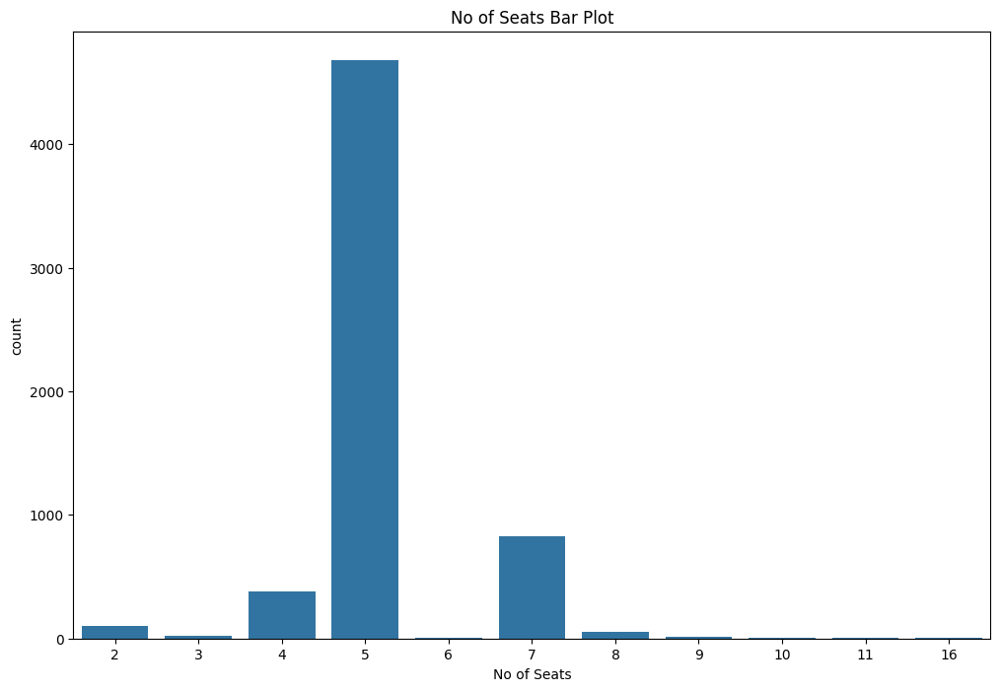

In [31]:
bar_plot(df_cleaned, "No of Seats")

Most of the cars have 5 seats. The next most common number of seats is 7.

##### Spare Key

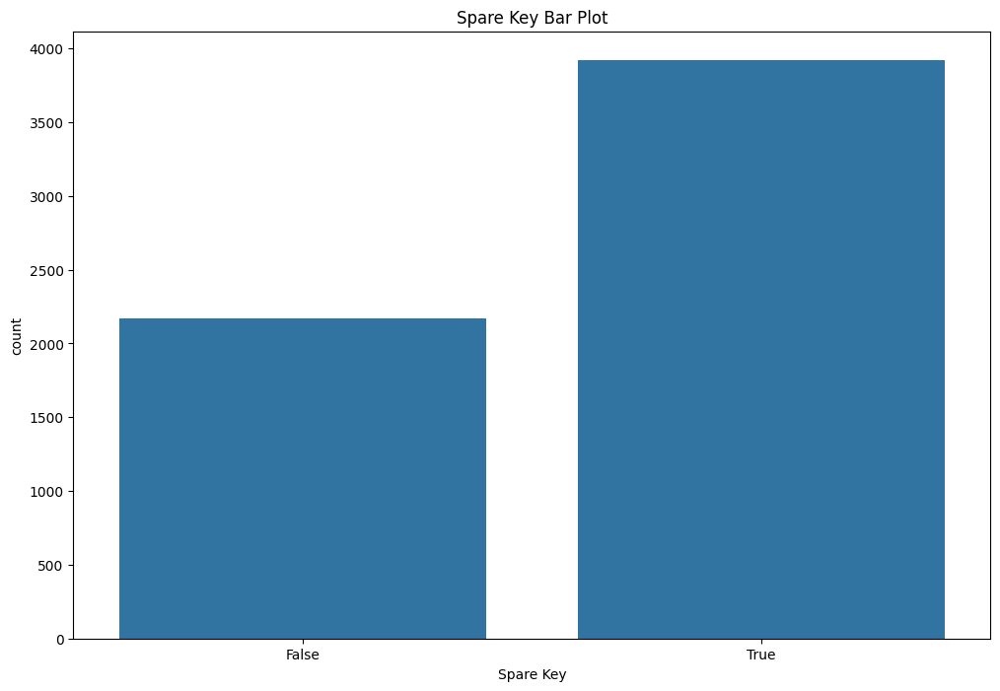

In [32]:
bar_plot(df_cleaned, "Spare Key")

The number of cars with a spare key is about twice as many as the number of cars without a spare key.

##### Transmission

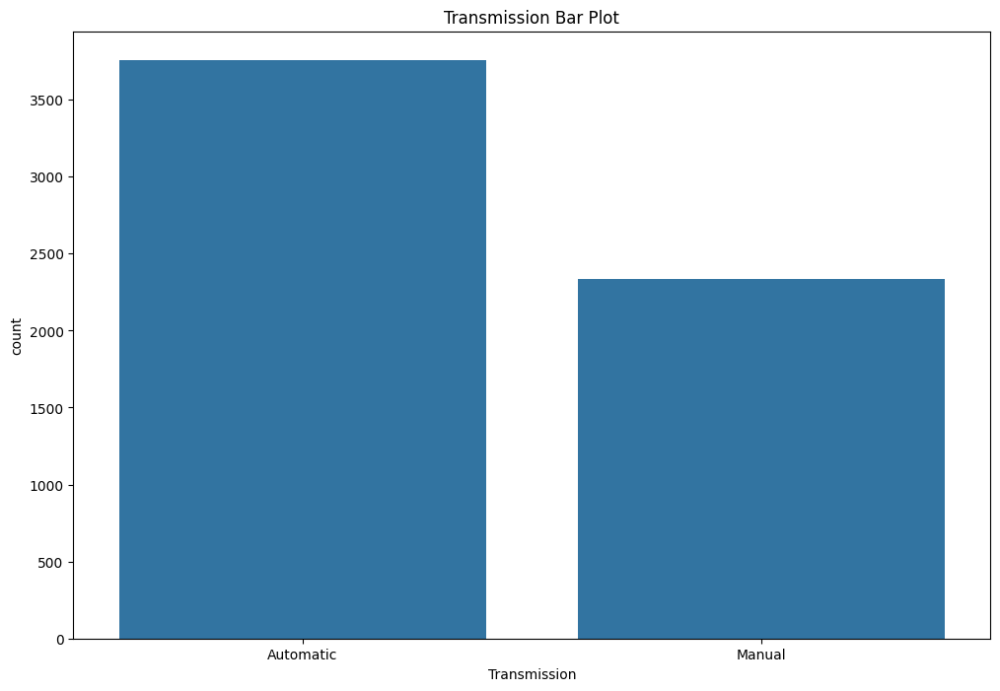

In [33]:
bar_plot(df_cleaned, "Transmission")

As we can see, the number of cars with an automatic transmission is about 1.5x as many as the number of cars with a manual transmission.

##### Vehicle Service History

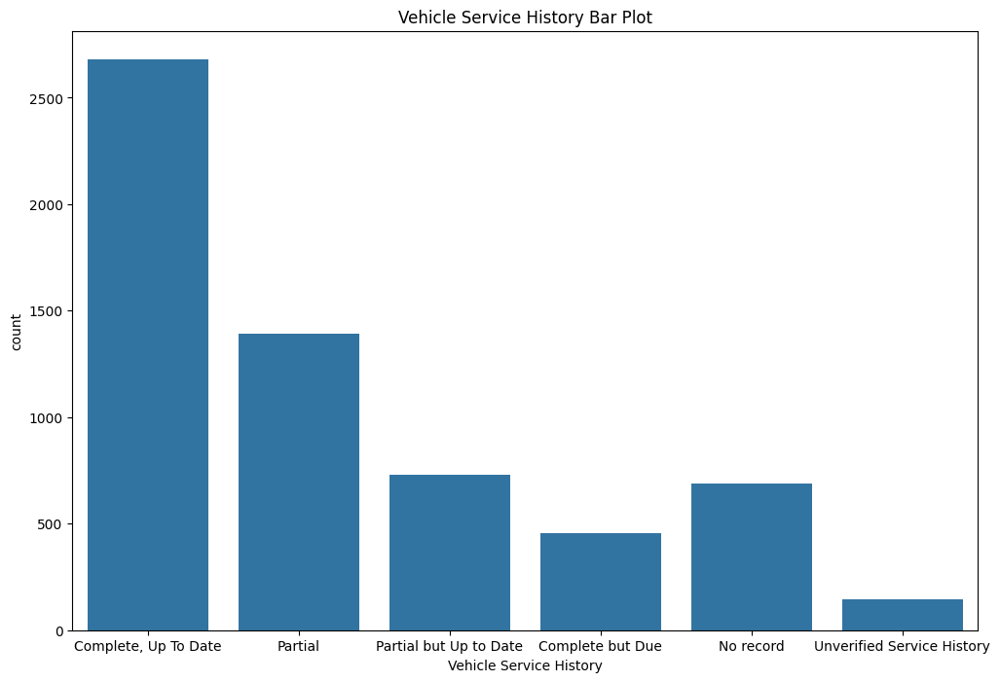

In [34]:
bar_plot(df_cleaned, "Vehicle Service History")

Most of the cars have a 'Complete, Up To Date' service history. The next most common service history is 'Partial'.

##### Price

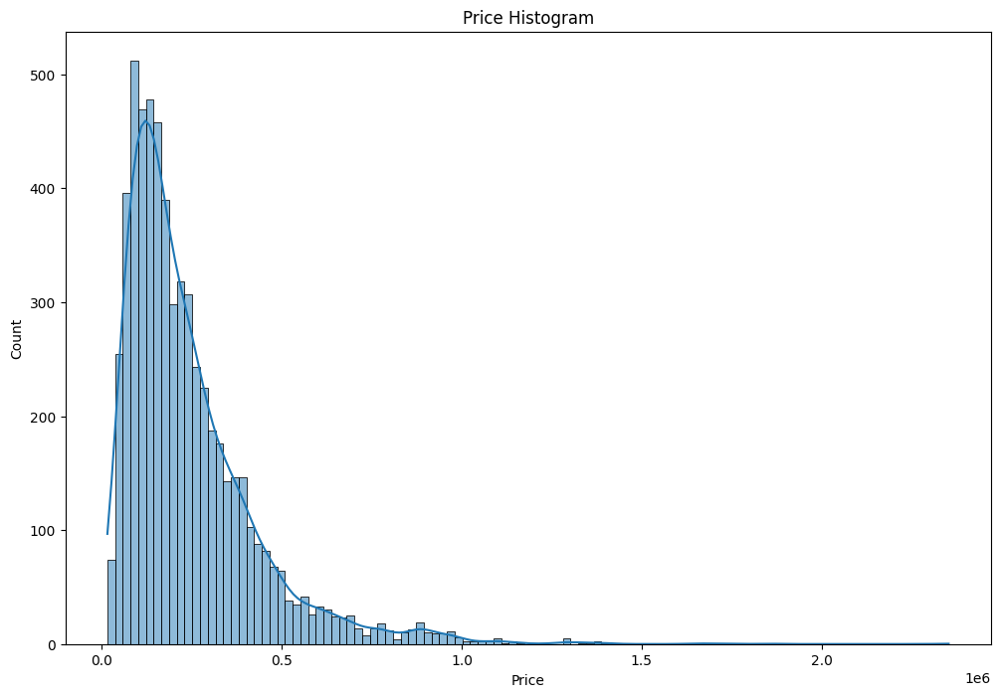

In [35]:
hist_plot(df_cleaned, "Price")

As we can see, the distribution of the `Price` column is right-skewed and approximately a normal distribution. Most of the cars are priced around 200,000.

#### Ranking

##### Top 10 Makes

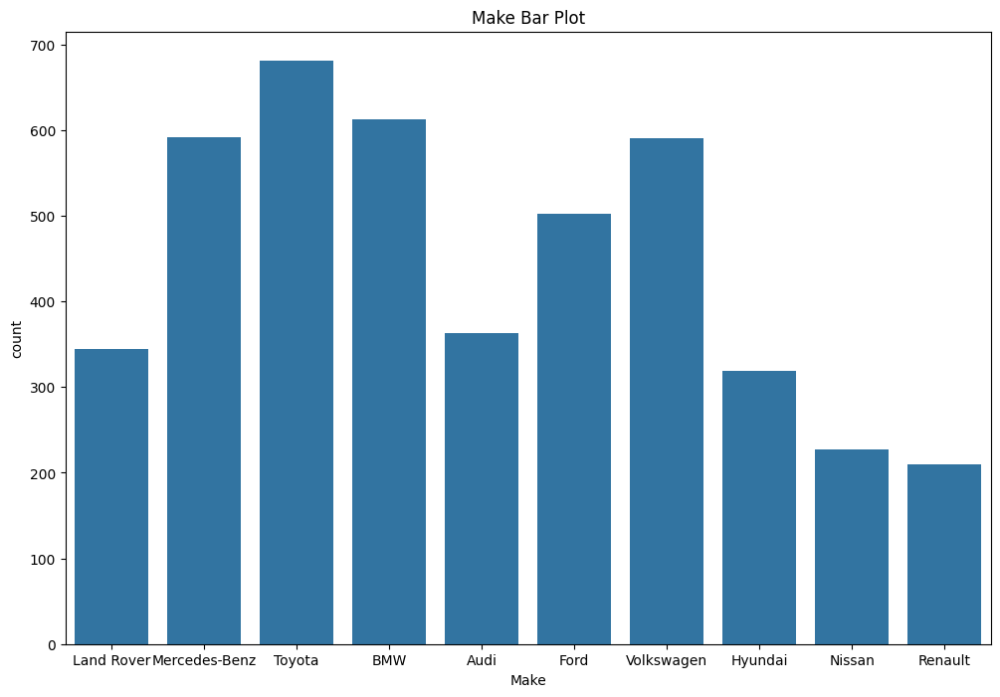

In [36]:
top_10_makes = df_cleaned["Make"].value_counts().head(10).index.values
df_temp = df_cleaned[df_cleaned["Make"].isin(top_10_makes)]
bar_plot(df_temp, "Make")

##### Top 10 Models

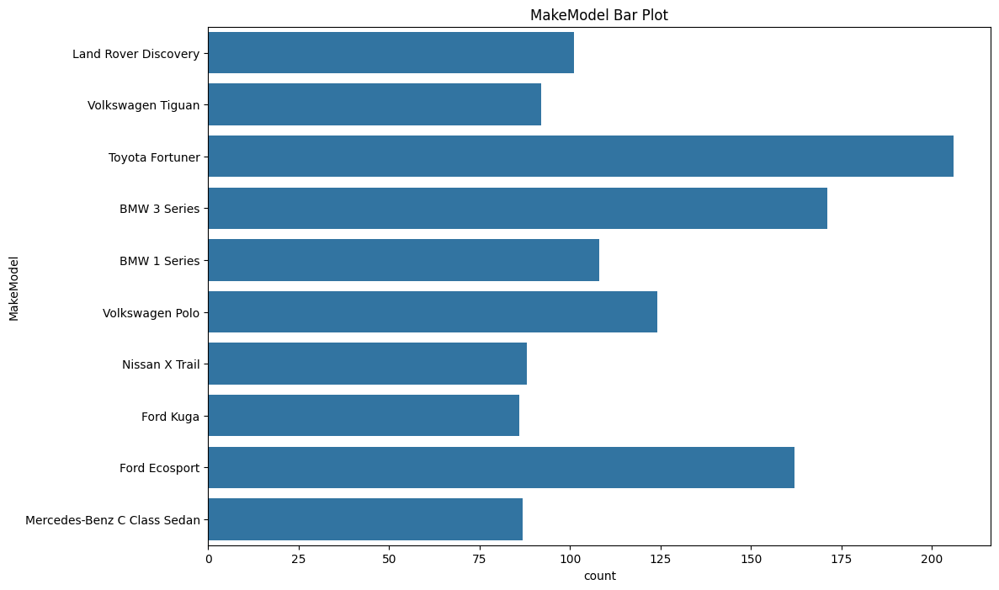

In [37]:
top_10_models = df_cleaned["Model"].value_counts().head(10).index.values
df_temp = df_cleaned[df_cleaned["Model"].isin(top_10_models)].assign(MakeModel = lambda x: x["Make"] + " " + x["Model"])
bar_plot(df_temp, "MakeModel", horizontal=True)

As we can see, the top 3 models are:

- Toyota Fortuner
- BMW 3 Series
- Ford Ecosport

##### Top 3 Body Types

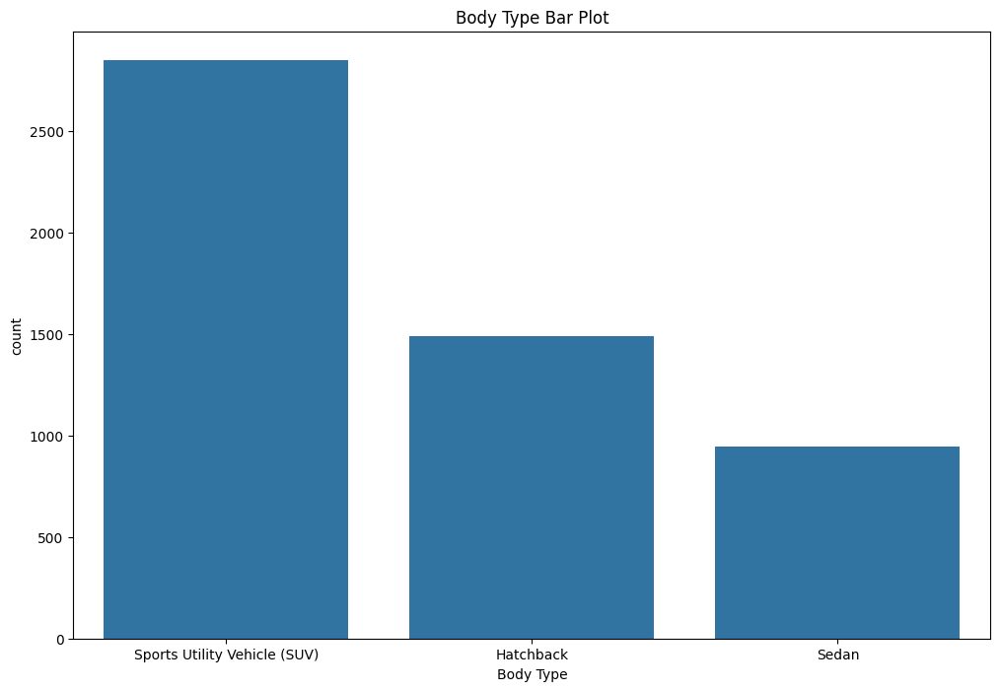

In [38]:
top_3_body_types = df_cleaned["Body Type"].value_counts().head(3).index.values
df_temp = df_cleaned[df_cleaned["Body Type"].isin(top_3_body_types)]
bar_plot(df_temp, "Body Type")

As We can see, most of the cars are SUVs, then Hatchback, and the third famous body type is Sedan.

##### Top 3 Colours

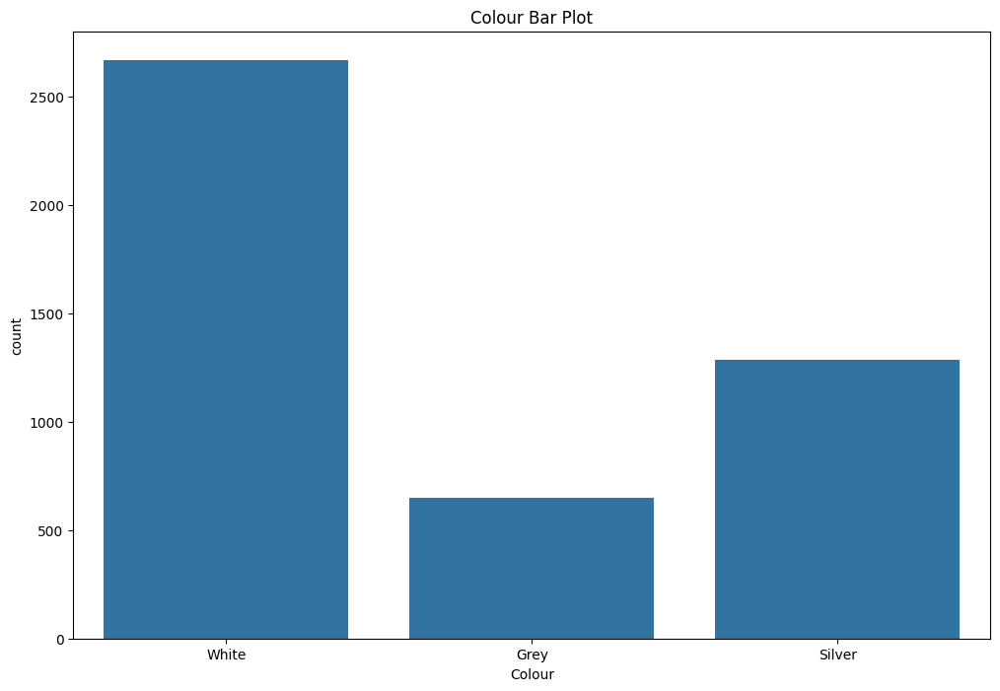

In [39]:
top_3_colours = df_cleaned["Colour"].value_counts().head(3).index.values
df_temp = df_cleaned[df_cleaned["Colour"].isin(top_3_colours)]
bar_plot(df_temp, "Colour")

White is the most famous colour in the dataset. The next famous colour is silver which is almost half of the White cars. The third one is Grey.

##### Top 3 Cylinder Layout

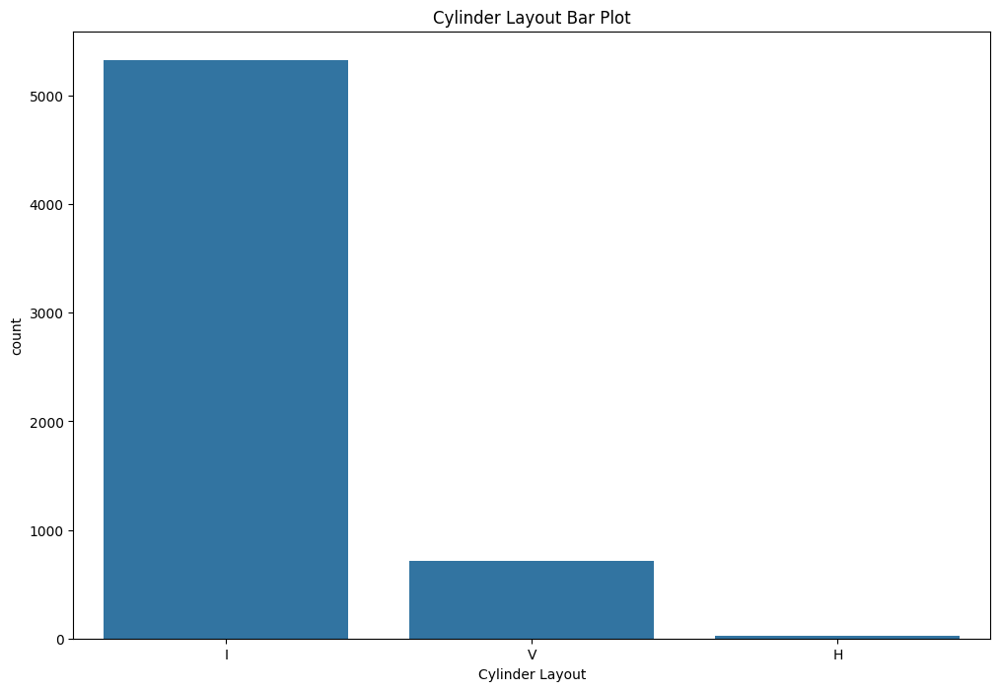

In [40]:
df_temp = df_cleaned.copy()
df_temp["Cylinder Layout"] = df_temp["Cylinder Layout"].apply(lambda x: x[0])
top_3_cylinder_layouts = df_temp["Cylinder Layout"].value_counts().head(3).index.values
df_temp = df_temp[df_temp["Cylinder Layout"].isin(top_3_cylinder_layouts)]
bar_plot(df_temp, "Cylinder Layout")

The most common cylinder layout is 'l', followed by 'V'.

#### Relationships

In [41]:
def plot_relationship(df: pd.DataFrame, x: str, y: str, plot_avg: bool = True) -> None:
    avg = df.groupby(x)[y].mean()
    plt.figure(figsize=(12, 8))
    sns.scatterplot(data=df, x=x, y=y)
    if plot_avg:
        plt.plot(avg.index, avg, color="red", label="Average")
    plt.title(f"{x} vs {y}")
    plt.show()

##### Price vs. Registration Year

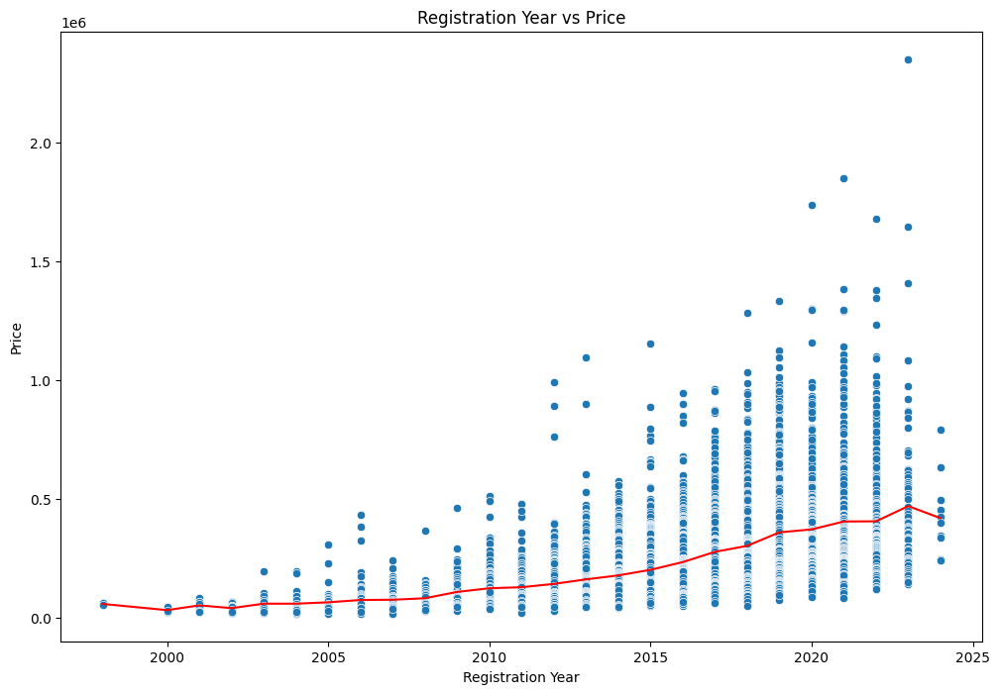

In [42]:
plot_relationship(df_cleaned, "Registration Year", "Price")

As it is visible in the above plot, we can see low prices for all the years. However, the highest prices are mostly seen in the last years.

Also, we can see that the average price of the cars is increasing with the registration year. This is expected as newer cars are usually more expensive.

##### Price vs. Mileage

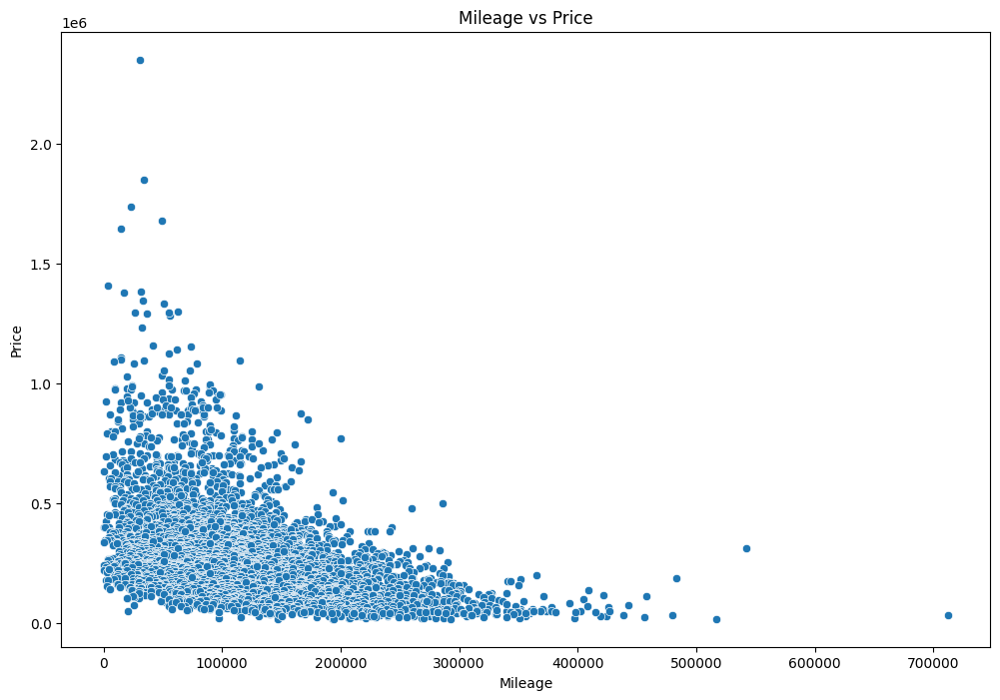

In [43]:
plot_relationship(df_cleaned, "Mileage", "Price", plot_avg=False)

As it is visible in the above plot, the price of the cars is decreasing with the mileage. This is expected as cars with higher mileage are usually cheaper.

##### Mileage vs. Registration Year

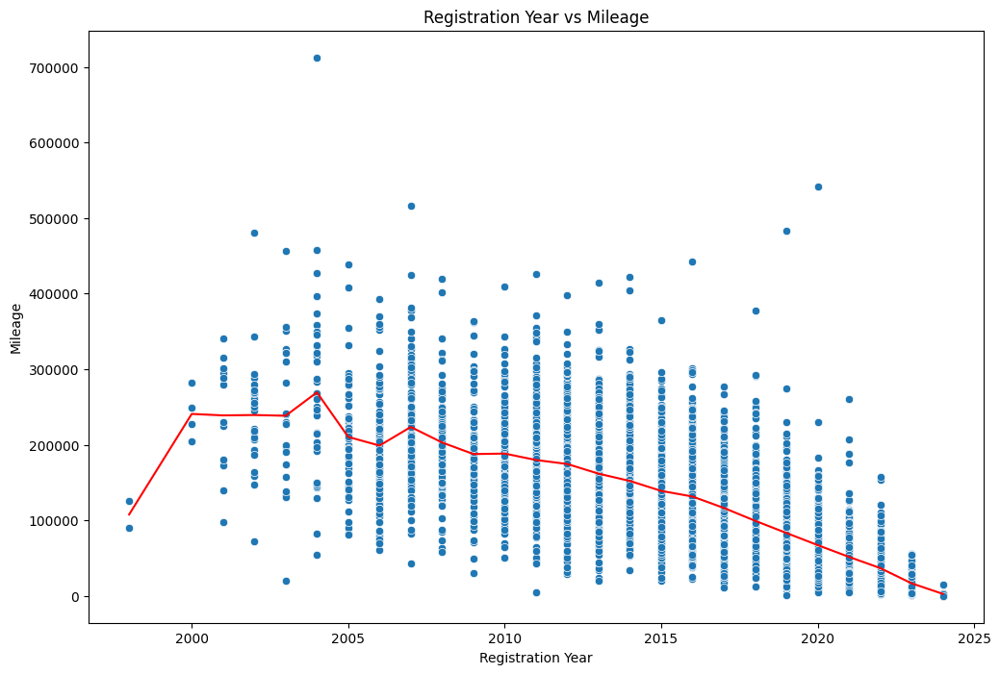

In [44]:
plot_relationship(df_cleaned, "Registration Year", "Mileage")

As it is visible in the above plot, the mileage of the cars is decreasing with the registration year. This is expected as older cars are usually driven more.

##### Engine Capacity vs. Kilowatts

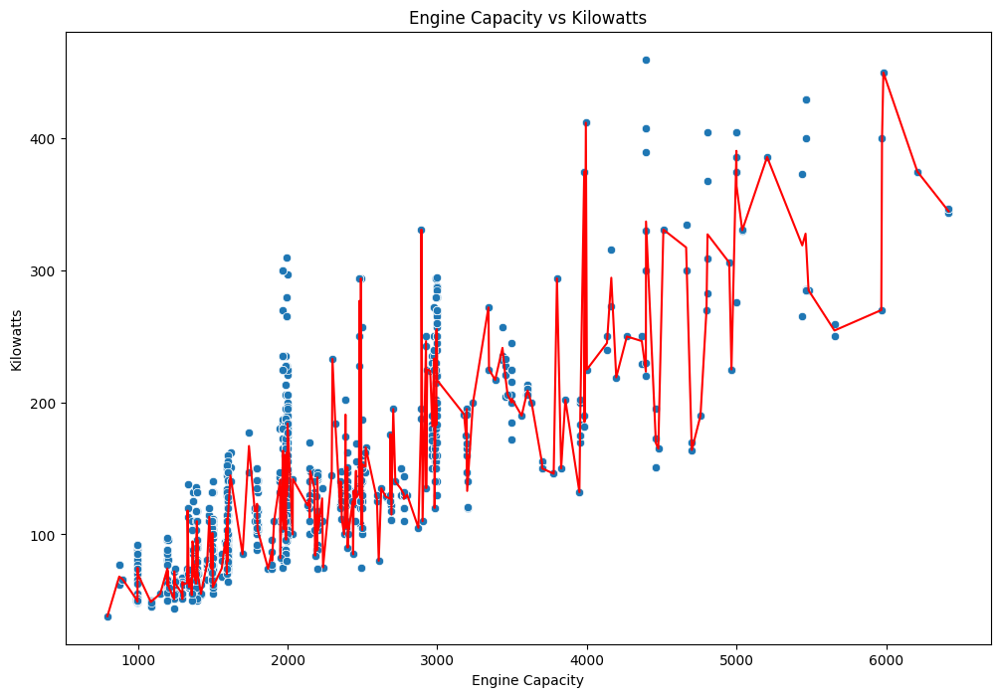

In [45]:
plot_relationship(df_cleaned, "Engine Capacity", "Kilowatts")

We can see that the kilowatts mostly increase with the engine capacity. This is expected as the engine capacity is related to the power of the car. However, we can see many up and downs in the plot. This is because the engine capacity is not the only factor that determines the power of the car.

##### Finance Price vs. Price

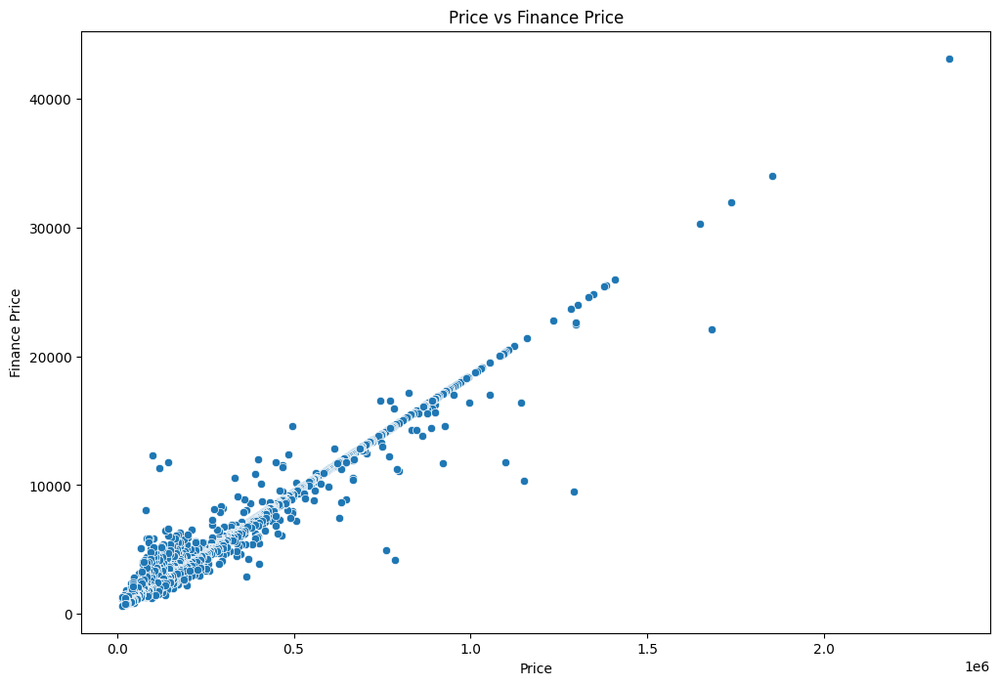

In [46]:
plot_relationship(df_cleaned, "Price", "Finance Price", plot_avg=False)

As it is visible in the above plot, the finance price is highly correlated with the price of the car. This is expected as the finance price is usually related to the selling price of the car.

#### Outliers

##### Age of the Car

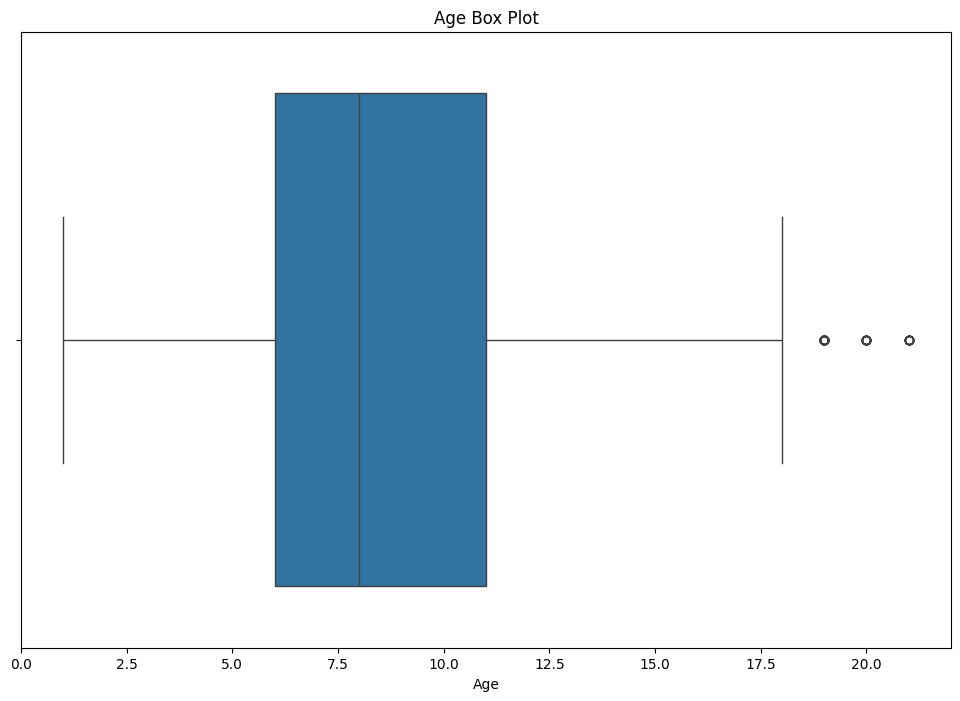

In [47]:
box_plot(df_processed, "Age")

In [48]:
df_processed[df_processed["Age"] > 20]

,Age,Body Type_Bus,Body Type_Cabriolet,Body Type_Coupe,Body Type_Crossover (SUV),Body Type_Hatchback,Body Type_Multi Purpose Vehicle,Body Type_Other,Body Type_Sedan,Body Type_Sports Utility Vehicle (SUV),...,Mileage,No of Cylinders,No of Doors,No of Seats,Remaining Maintenance Plan,Remaining Warranty,Spare Key,Transmission,Vehicle Service History,Price
4552,21,False,False,False,False,True,False,False,False,False,...,200000,4,5,5,0,0,True,1,4,58900
4635,21,False,False,False,False,False,False,False,False,True,...,230000,4,5,5,0,0,False,1,4,53900
4715,21,False,False,False,False,False,False,False,True,False,...,20600,4,4,5,0,0,False,0,4,46900
4727,21,False,False,False,False,True,False,False,False,False,...,281823,4,5,5,0,0,False,1,3,44000
4780,21,False,False,False,False,True,False,False,False,False,...,240000,4,5,5,0,0,False,1,3,39900
4782,21,False,False,False,False,False,False,False,True,False,...,157000,4,4,5,0,0,True,0,4,71900
4840,21,False,False,False,False,False,False,False,True,False,...,190000,6,4,5,0,0,True,0,4,57900
4863,21,False,False,False,False,True,False,False,False,False,...,131000,4,5,4,0,0,True,1,3,65900
4865,21,False,False,False,False,True,False,False,False,False,...,138667,4,3,4,0,0,True,1,3,65900
4913,21,False,False,False,False,False,False,False,True,False,...,174031,6,4,5,0,0,True,0,3,48000


##### Finance Price

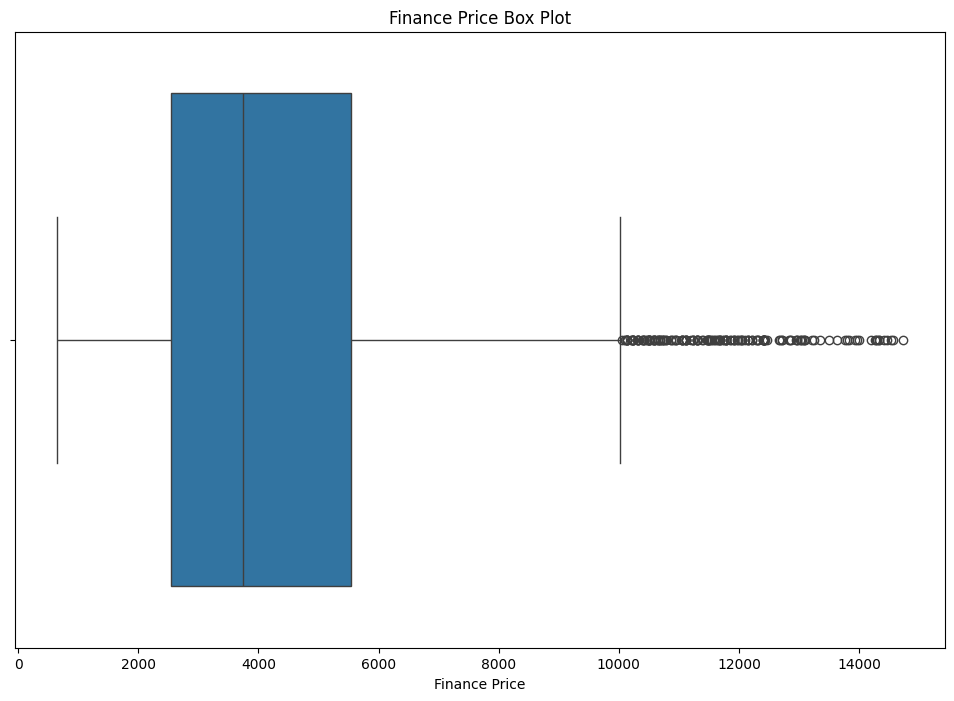

In [49]:
box_plot(df_processed, "Finance Price")

In [50]:
df_processed[df_processed["Finance Price"] > 12000]

,Age,Body Type_Bus,Body Type_Cabriolet,Body Type_Coupe,Body Type_Crossover (SUV),Body Type_Hatchback,Body Type_Multi Purpose Vehicle,Body Type_Other,Body Type_Sedan,Body Type_Sports Utility Vehicle (SUV),...,Mileage,No of Cylinders,No of Doors,No of Seats,Remaining Maintenance Plan,Remaining Warranty,Spare Key,Transmission,Vehicle Service History,Price
0,5,False,False,False,False,False,True,False,False,False,...,125000,4,5,7,0,0,False,0,3,767900
1,5,False,False,False,False,False,False,False,False,True,...,65871,4,5,5,0,0,False,0,0,767900
2,9,False,False,False,False,False,False,False,False,True,...,142000,6,5,7,0,0,False,0,3,766900
3,4,False,False,False,False,False,False,False,False,True,...,59000,4,5,5,367,367,True,0,0,765900
4,5,False,False,False,False,False,False,False,False,True,...,86000,6,5,4,0,0,True,0,0,764900
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
68,5,False,False,False,False,False,False,False,False,True,...,132454,6,5,5,0,0,True,0,3,647900
70,5,False,False,False,False,False,False,False,True,False,...,91000,6,4,5,155,155,True,0,0,645900
74,5,False,False,False,False,False,False,False,False,True,...,57000,4,5,5,0,0,True,0,0,642900
77,5,False,False,False,False,False,False,False,False,True,...,85566,4,5,7,0,0,True,0,0,642900


##### Fuel Consumption

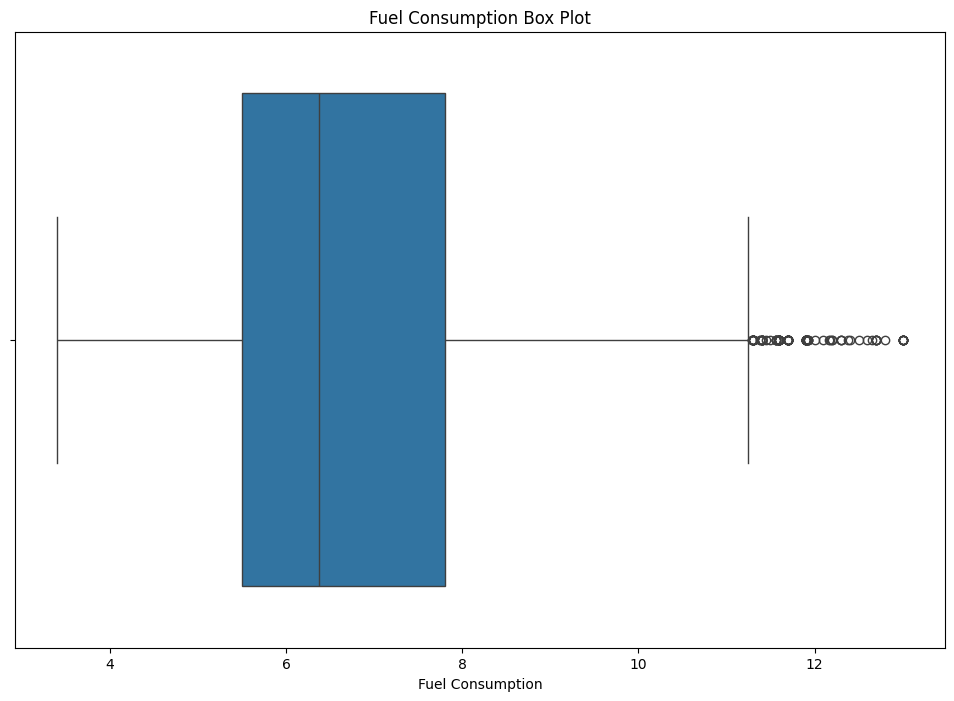

In [51]:
box_plot(df_processed, "Fuel Consumption")

In [52]:
df_processed[df_processed["Fuel Consumption"] > 12]

,Age,Body Type_Bus,Body Type_Cabriolet,Body Type_Coupe,Body Type_Crossover (SUV),Body Type_Hatchback,Body Type_Multi Purpose Vehicle,Body Type_Other,Body Type_Sedan,Body Type_Sports Utility Vehicle (SUV),...,Mileage,No of Cylinders,No of Doors,No of Seats,Remaining Maintenance Plan,Remaining Warranty,Spare Key,Transmission,Vehicle Service History,Price
617,9,False,False,False,False,False,False,False,False,True,...,77560,6,5,7,0,0,True,0,0,377900
1400,9,False,False,False,False,False,False,False,False,True,...,110000,6,5,7,0,0,True,0,1,270900
1481,11,False,False,False,False,False,False,False,False,True,...,194530,6,5,7,0,0,True,0,0,260900
1648,13,False,False,False,False,False,False,False,False,True,...,148000,6,5,7,0,0,True,0,3,251900
1925,11,False,False,False,False,False,False,False,False,True,...,162002,6,5,7,0,0,False,0,4,223900
2008,11,False,False,False,False,False,False,False,False,True,...,172000,6,5,7,0,0,False,0,2,208900
2089,12,False,False,False,False,False,False,False,False,True,...,165000,6,5,7,0,0,True,0,0,210900
2255,14,False,False,False,False,False,False,False,False,True,...,118961,6,5,7,0,0,True,0,1,188900
2368,14,False,False,False,False,False,False,False,False,True,...,155000,6,5,7,0,0,True,0,0,187900
2556,14,False,False,False,False,False,False,False,False,True,...,201279,6,5,7,0,0,True,0,2,174000


##### Fuel Tank Capacity

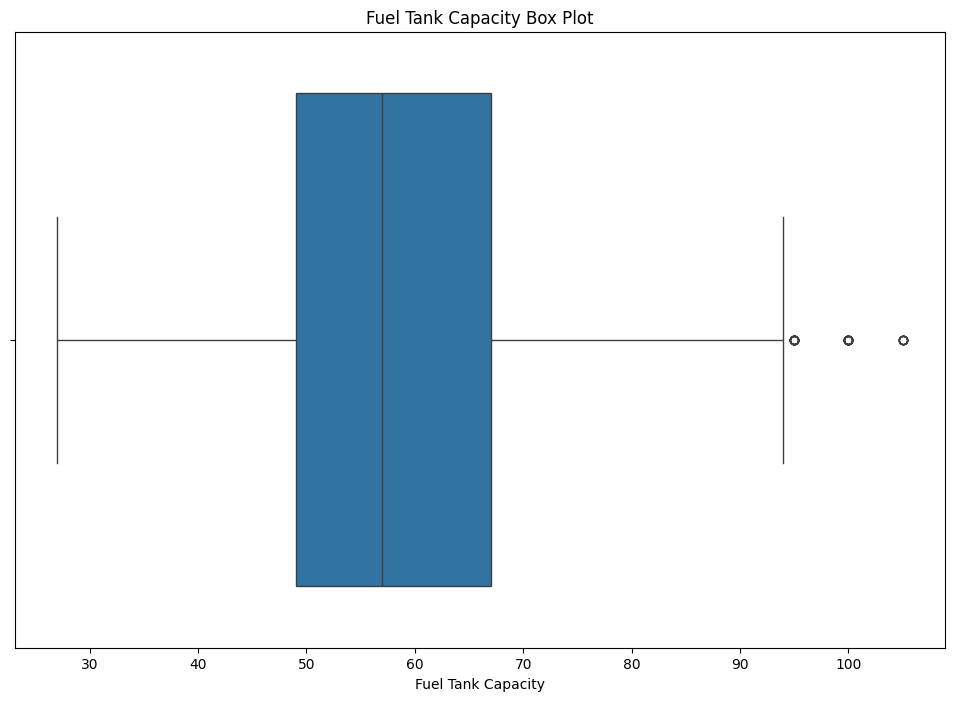

In [53]:
box_plot(df_processed, "Fuel Tank Capacity")

In [54]:
df_processed[df_processed["Fuel Tank Capacity"] > 100]

,Age,Body Type_Bus,Body Type_Cabriolet,Body Type_Coupe,Body Type_Crossover (SUV),Body Type_Hatchback,Body Type_Multi Purpose Vehicle,Body Type_Other,Body Type_Sedan,Body Type_Sports Utility Vehicle (SUV),...,Mileage,No of Cylinders,No of Doors,No of Seats,Remaining Maintenance Plan,Remaining Warranty,Spare Key,Transmission,Vehicle Service History,Price
233,10,False,False,False,False,False,False,False,False,True,...,84000,6,5,5,0,0,True,0,0,491900
243,9,False,False,False,False,False,False,False,False,True,...,95000,6,5,5,0,0,True,0,2,479900
345,8,False,False,False,False,False,False,False,False,True,...,181000,6,5,5,0,0,False,0,1,451900
512,10,False,False,False,False,False,False,False,False,True,...,104000,6,5,5,0,0,True,0,1,397900
598,8,False,False,False,False,False,False,False,False,True,...,229000,6,5,5,0,0,False,0,4,379900
639,10,False,False,False,False,False,False,False,False,True,...,174000,6,5,5,0,0,True,0,3,371900
934,10,False,False,False,False,False,False,False,False,True,...,122040,6,5,5,0,0,False,0,4,325900


##### Horsepower

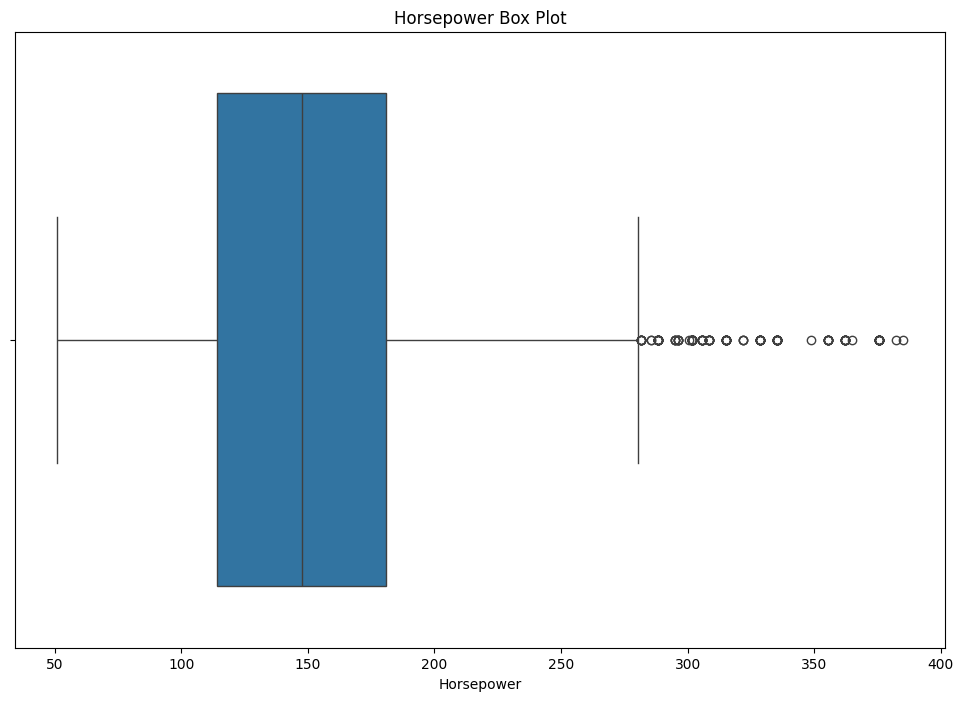

In [55]:
box_plot(df_processed, "Horsepower")

In [56]:
df_processed[df_processed["Horsepower"] > 300]

,Age,Body Type_Bus,Body Type_Cabriolet,Body Type_Coupe,Body Type_Crossover (SUV),Body Type_Hatchback,Body Type_Multi Purpose Vehicle,Body Type_Other,Body Type_Sedan,Body Type_Sports Utility Vehicle (SUV),...,Mileage,No of Cylinders,No of Doors,No of Seats,Remaining Maintenance Plan,Remaining Warranty,Spare Key,Transmission,Vehicle Service History,Price
4,5,False,False,False,False,False,False,False,False,True,...,86000,6,5,4,0,0,True,0,0,764900
5,7,False,False,False,False,False,False,False,False,True,...,69153,6,5,5,0,0,True,0,0,760900
14,7,False,False,False,False,False,False,False,False,True,...,109000,6,5,5,0,0,False,0,1,740900
15,5,False,False,False,False,False,False,False,False,True,...,109000,6,5,5,0,0,True,0,0,729900
19,6,False,False,False,False,False,False,False,False,True,...,107000,6,5,5,0,0,True,0,0,721000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3146,13,False,False,False,False,False,False,False,False,True,...,104000,4,5,5,0,0,False,0,4,145000
4274,13,False,False,False,False,False,False,False,False,True,...,337000,6,5,5,0,0,True,0,1,90900
4304,14,False,False,False,False,False,False,False,False,True,...,245000,6,5,5,0,0,True,0,0,71000
4313,15,False,False,False,False,False,False,False,True,False,...,215000,6,4,5,0,0,False,0,4,99900


##### Mileage

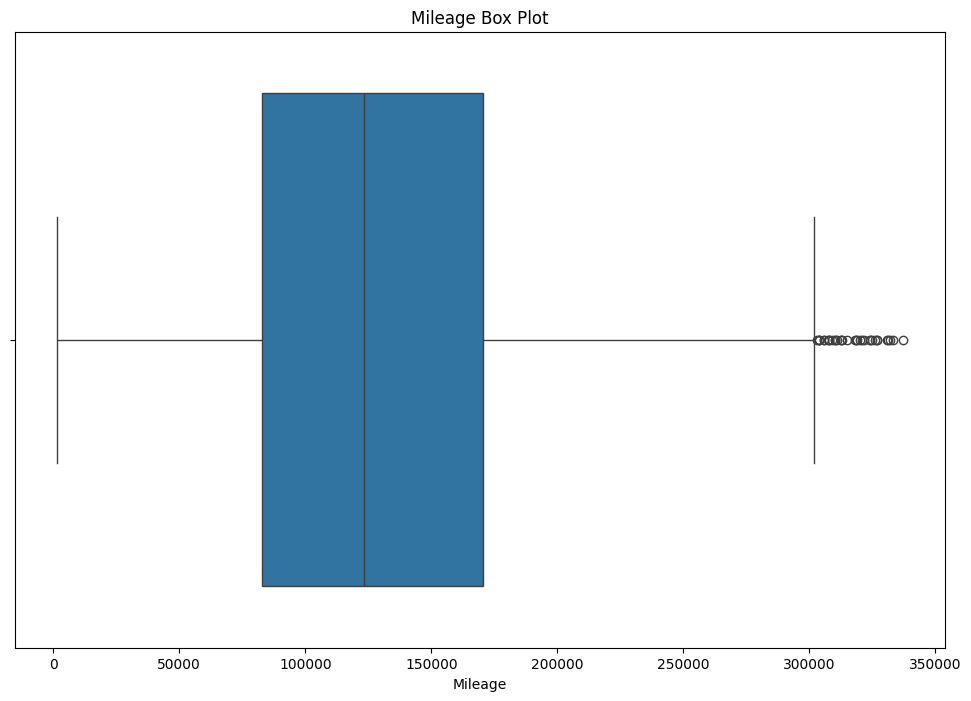

In [57]:
box_plot(df_processed, "Mileage")

In [58]:
df_processed[df_processed["Mileage"] > 310000]

,Age,Body Type_Bus,Body Type_Cabriolet,Body Type_Coupe,Body Type_Crossover (SUV),Body Type_Hatchback,Body Type_Multi Purpose Vehicle,Body Type_Other,Body Type_Sedan,Body Type_Sports Utility Vehicle (SUV),...,Mileage,No of Cylinders,No of Doors,No of Seats,Remaining Maintenance Plan,Remaining Warranty,Spare Key,Transmission,Vehicle Service History,Price
3484,10,False,False,False,False,False,False,False,False,True,...,327000,4,5,5,0,0,False,0,0,121900
3512,14,False,False,False,False,False,False,False,False,True,...,326757,6,5,7,0,0,False,0,3,115000
3539,11,False,False,False,False,False,False,False,False,True,...,325000,4,5,7,0,0,True,0,0,119900
3905,11,False,False,False,False,False,False,False,False,True,...,324000,4,5,7,0,0,True,0,1,99900
4164,12,False,False,False,False,False,False,False,True,False,...,333388,4,4,5,0,0,False,0,4,95000
4199,16,False,False,False,False,False,False,False,False,True,...,321500,6,5,5,0,0,True,0,3,85900
4256,16,False,False,False,False,False,False,False,False,True,...,312433,6,5,7,0,0,False,0,4,78900
4274,13,False,False,False,False,False,False,False,False,True,...,337000,6,5,5,0,0,True,0,1,90900
4357,15,False,False,False,False,False,False,False,False,True,...,320000,4,5,5,0,0,False,0,4,74900
4358,17,False,False,False,False,False,False,False,False,True,...,326100,6,5,7,0,0,True,0,4,74900


##### Price

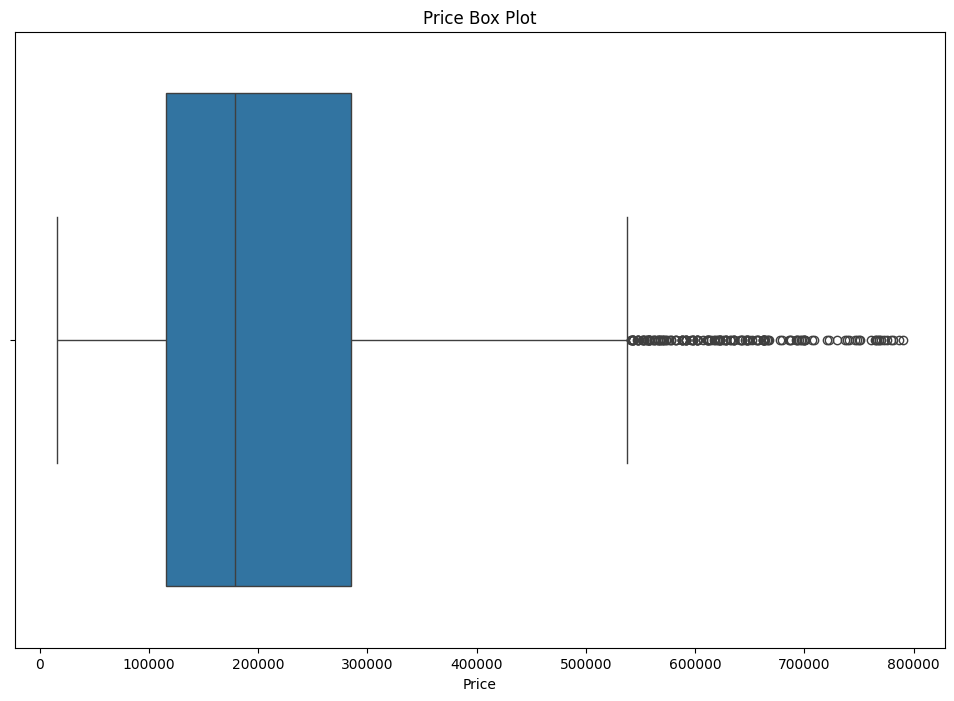

In [59]:
box_plot(df_processed, "Price")

In [60]:
df_processed[df_processed["Price"] > 600000]

,Age,Body Type_Bus,Body Type_Cabriolet,Body Type_Coupe,Body Type_Crossover (SUV),Body Type_Hatchback,Body Type_Multi Purpose Vehicle,Body Type_Other,Body Type_Sedan,Body Type_Sports Utility Vehicle (SUV),...,Mileage,No of Cylinders,No of Doors,No of Seats,Remaining Maintenance Plan,Remaining Warranty,Spare Key,Transmission,Vehicle Service History,Price
0,5,False,False,False,False,False,True,False,False,False,...,125000,4,5,7,0,0,False,0,3,767900
1,5,False,False,False,False,False,False,False,False,True,...,65871,4,5,5,0,0,False,0,0,767900
2,9,False,False,False,False,False,False,False,False,True,...,142000,6,5,7,0,0,False,0,3,766900
3,4,False,False,False,False,False,False,False,False,True,...,59000,4,5,5,367,367,True,0,0,765900
4,5,False,False,False,False,False,False,False,False,True,...,86000,6,5,4,0,0,True,0,0,764900
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94,7,False,False,False,False,False,False,False,False,True,...,123167,6,5,4,0,0,True,0,0,602900
95,3,True,False,False,False,False,False,False,False,False,...,36000,4,5,8,0,0,False,0,0,601900
96,3,False,False,False,False,False,False,False,False,True,...,62034,4,5,7,0,0,True,0,0,601900
97,3,False,False,False,False,False,False,False,False,True,...,63000,4,5,5,0,0,False,0,0,601900
